In [1]:
from __future__ import absolute_import, division, print_function, unicode_literals

!pip install tf-nightly-gpu-2.0-preview
!pip install matplotlib
!pip install scipy

import tensorflow as tf

import os
import numpy as np
import matplotlib.pyplot as plt

In [2]:
tf.__version__

'2.0.0-dev20190615'

In [6]:
import os
from PIL import Image

MAIN_PATHS = ['./images/bemisia tabaci', './images/tetranychus urticae']

broken_images = 0
images = 0

for path in MAIN_PATHS:
    for image in os.listdir(path):
        try:
            images += 1
            filename = os.path.join(path, image)
            im = Image.open(filename)
            im.verify() #I perform also verify, don't know if he sees other types o defects
            im.close() #reload is necessary in my case
            im = Image.open(filename)
            im.transpose(Image.FLIP_LEFT_RIGHT)
            im.close()
        except Exception as e:
            print(filename, e)
            os.remove(filename)
            broken_images += 1
#os.remove('./images/tetranychus urticae/238.Foto-121.jpg')
print(images, broken_images)

442 0


In [9]:
base_dir = './images/'
print(os.listdir(base_dir))
#import shutil
#shutil.rmtree('./images/.DS_Store')

['bemisia tabaci', 'tetranychus urticae', '.DS_Store']


In [12]:
IMAGE_SIZE = 224
BATCH_SIZE = 64

datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255, 
    validation_split=0.2,
    horizontal_flip=True, vertical_flip=True, rotation_range=360)

train_generator = datagen.flow_from_directory(
    base_dir,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE, 
    subset='training')

val_generator = datagen.flow_from_directory(
    base_dir,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE, 
    subset='validation')

Found 351 images belonging to 2 classes.
Found 86 images belonging to 2 classes.


In [13]:
for image_batch, label_batch in train_generator:
  break
image_batch.shape, label_batch.shape

((64, 224, 224, 3), (64, 2))

In [14]:
print (train_generator.class_indices)

labels = '\n'.join(sorted(train_generator.class_indices.keys()))

with open('labels.txt', 'w') as f:
  f.write(labels)

{'bemisia tabaci': 0, 'tetranychus urticae': 1}


In [15]:
IMG_SHAPE = (IMAGE_SIZE, IMAGE_SIZE, 3)

# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                              include_top=False, 
                                              weights='imagenet')

9412608/9406464 [==============================] - 1s 0us/step


In [16]:
base_model.trainable = False

In [17]:
model = tf.keras.Sequential([
  base_model,
  tf.keras.layers.Conv2D(64, 3, activation='relu'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Conv2D(32, 3, activation='relu'),
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(2, activation='softmax')
])

In [18]:
model.compile(optimizer=tf.keras.optimizers.Adam(), 
              loss='categorical_crossentropy', 
              metrics=['accuracy'])

In [19]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Model) (None, 7, 7, 1280)        2257984   
_________________________________________________________________
conv2d (Conv2D)              (None, 5, 5, 64)          737344    
_________________________________________________________________
dropout (Dropout)            (None, 5, 5, 64)          0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 3, 3, 32)          18464     
_________________________________________________________________
dropout_1 (Dropout)          (None, 3, 3, 32)          0         
_________________________________________________________________
global_average_pooling2d (Gl (None, 32)                0         
_________________________________________________________________
dense (Dense)                (None, 2)                 6

In [20]:
print('Number of trainable variables = {}'.format(len(model.trainable_variables)))

Number of trainable variables = 6


In [21]:
epochs = 5

history = model.fit(train_generator, 
                    epochs=epochs, 
                    validation_data=val_generator)

Epoch 1/5


W0615 18:43:06.312989 140109405234944 deprecation.py:323] From /export/JEFFDEANDISK/ccrespo/notebooks/bugs_venv/lib/python3.5/site-packages/tensorflow_core/python/ops/math_grad.py:1251: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


6/6 [==============================] - 19s 3s/step - loss: 1.5740 - accuracy: 0.5897 - val_loss: 0.5148 - val_accuracy: 0.7442
Epoch 2/5
6/6 [==============================] - 11s 2s/step - loss: 0.4340 - accuracy: 0.8091 - val_loss: 0.4720 - val_accuracy: 0.7558
Epoch 3/5
6/6 [==============================] - 13s 2s/step - loss: 0.4115 - accuracy: 0.8262 - val_loss: 0.5184 - val_accuracy: 0.8023
Epoch 4/5
6/6 [==============================] - 13s 2s/step - loss: 0.3458 - accuracy: 0.8462 - val_loss: 0.3343 - val_accuracy: 0.8140
Epoch 5/5
6/6 [==============================] - 12s 2s/step - loss: 0.3356 - accuracy: 0.8462 - val_loss: 0.4535 - val_accuracy: 0.8256


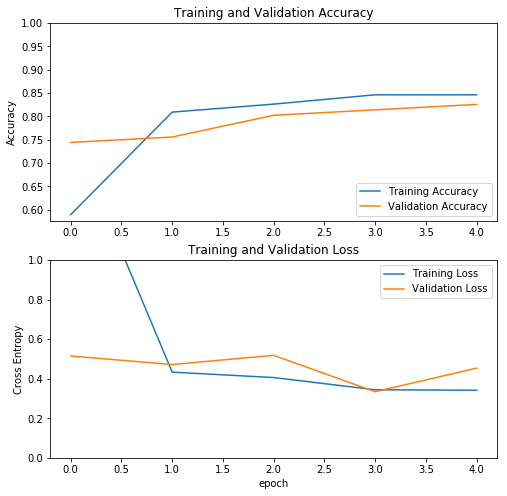

In [22]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [91]:
#probabilities = model.predict_generator(val_generator)
#print(probabilities)
current_labels = ['bemisia tabaci', 'tetranychus urticae']

total_samples = 0
correct_samples = 0
total_index_0 = 0
correct_index_0 = 0
total_index_1 = 0
correct_index_1 = 0

wrong_samples = []
correct_samples_list = []

filenames = val_generator.filenames
used_indexes = []
should_stop = False
while not should_stop:
    index = next(val_generator.index_generator)
    image, label = val_generator._get_batches_of_transformed_samples(index)

    predictions = model.predict(image)
    for i in range(predictions.shape[0]):
        if index[i] not in used_indexes:
            used_indexes.append(index[i])
            print(filenames[index[i]], current_labels[np.argmax(label[i])], current_labels[np.argmax(predictions[i])])
            
            total_samples += 1
            is_correct = current_labels[np.argmax(label[i])] == current_labels[np.argmax(predictions[i])]
            if is_correct:
                correct_samples += 1
                correct_samples_list.append(filenames[index[i]])
            else:
                wrong_samples.append(filenames[index[i]])
            
            if np.argmax(label[i]) == 0:
                total_index_0 += 1
                if is_correct:
                    correct_index_0 += 1
            elif np.argmax(label[i]) == 1:
                total_index_1 += 1
                if is_correct:
                    correct_index_1 += 1
            
    if len(used_indexes) == len(filenames):
        break
print(total_samples, correct_samples / total_samples, 
      total_index_0, correct_index_0 / total_index_0, 
      total_index_1, correct_index_1 / total_index_1)
print(wrong_samples)

bemisia tabaci/121.1024_whiteflies-Large-population-of-B-1024x612.jpg bemisia tabaci bemisia tabaci
bemisia tabaci/118.Bemisia-tabaci-568958.jpg bemisia tabaci bemisia tabaci
tetranychus urticae/116.5-Ficha-Tetranichus-1.jpg tetranychus urticae tetranychus urticae
bemisia tabaci/126.mosca12.jpg bemisia tabaci bemisia tabaci
tetranychus urticae/11.Tetranychus_urticae_with_silk_threads.jpg tetranychus urticae tetranychus urticae
tetranychus urticae/152.472px-Tetranychus-urticae.jpg tetranychus urticae tetranychus urticae
tetranychus urticae/117.foto11.jpg tetranychus urticae tetranychus urticae
bemisia tabaci/100.3413082.jpg bemisia tabaci bemisia tabaci
bemisia tabaci/130.copulate.jpg bemisia tabaci bemisia tabaci
bemisia tabaci/129.165wh.jpg bemisia tabaci bemisia tabaci
tetranychus urticae/111.92a5da17dfa5c215092b9a2e4dde1882.jpg tetranychus urticae tetranychus urticae
tetranychus urticae/124.Figura-13-Adultos-del-acaro-Tetranychus-urticae-en-hojas-de-gulupa-Foto-John-Ocampo.png tetra

tetranychus urticae/149.aoc3bbt-29.jpg


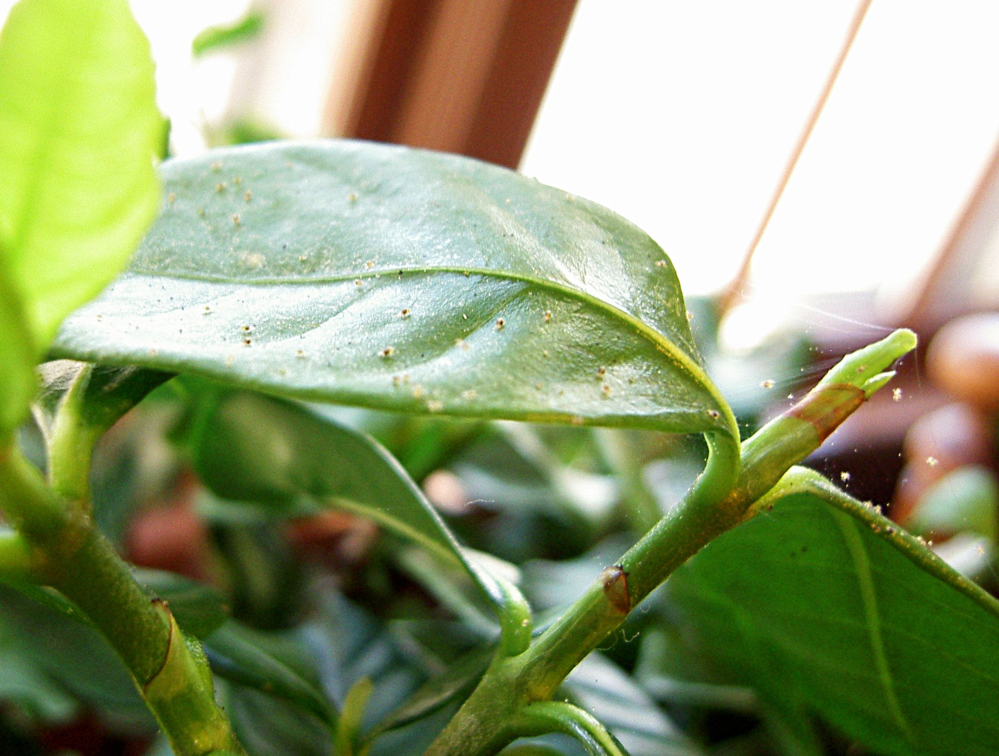

Press Enter to continue...
bemisia tabaci/100.3413082.jpg


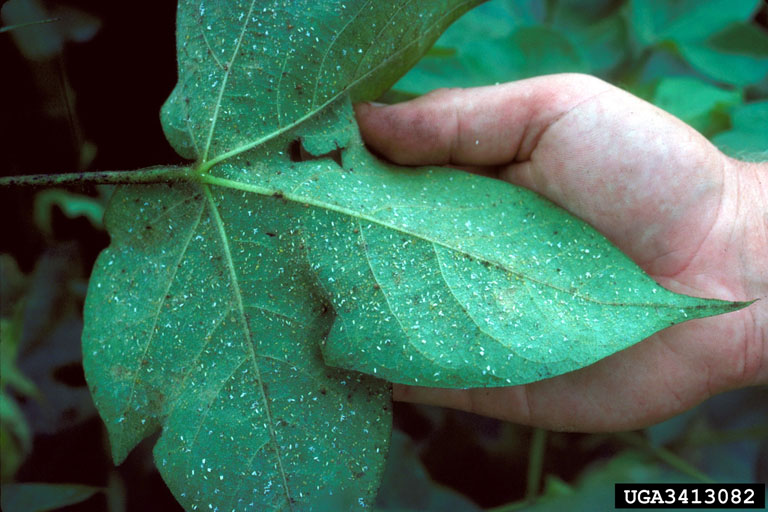

Press Enter to continue...
tetranychus urticae/120.1435140.jpg


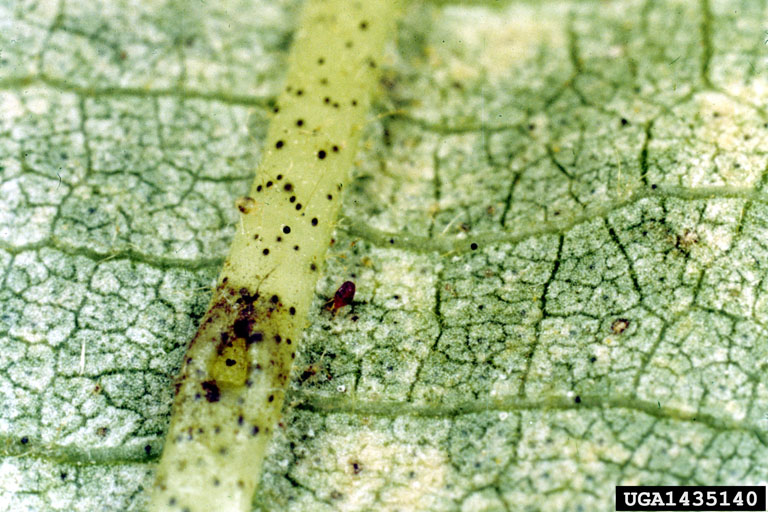

Press Enter to continue...
tetranychus urticae/126.Class-Arachnida-Trombidiformes-Tetranychidae-Tetranychus-urticae-Twospotted-Spider-Mite-A.jpg


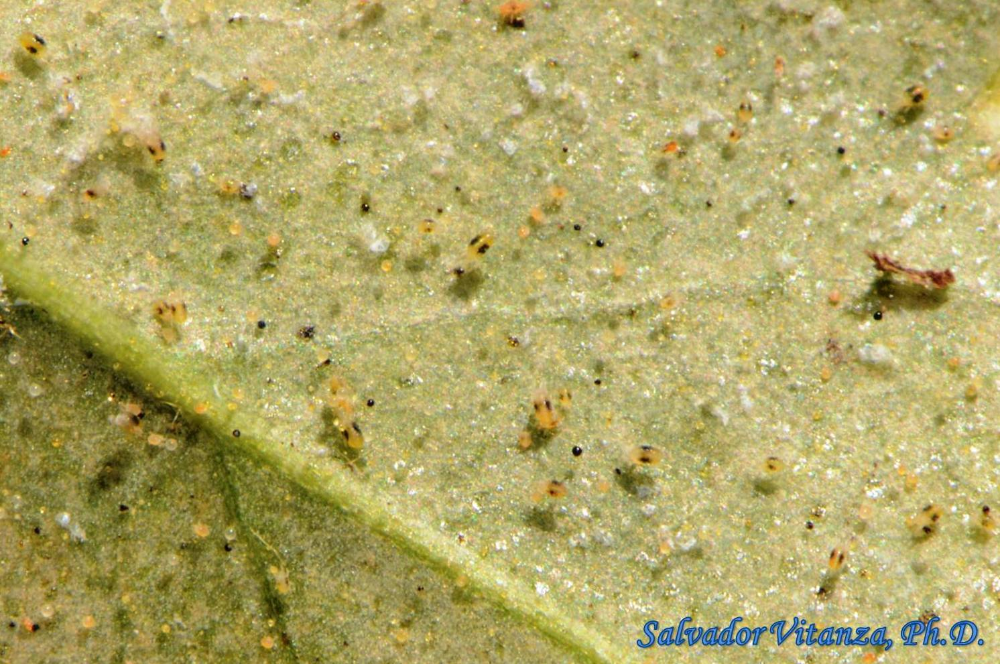

Press Enter to continue...
tetranychus urticae/101.1417141298_araniuelas-tetranychus-urticae.jpg


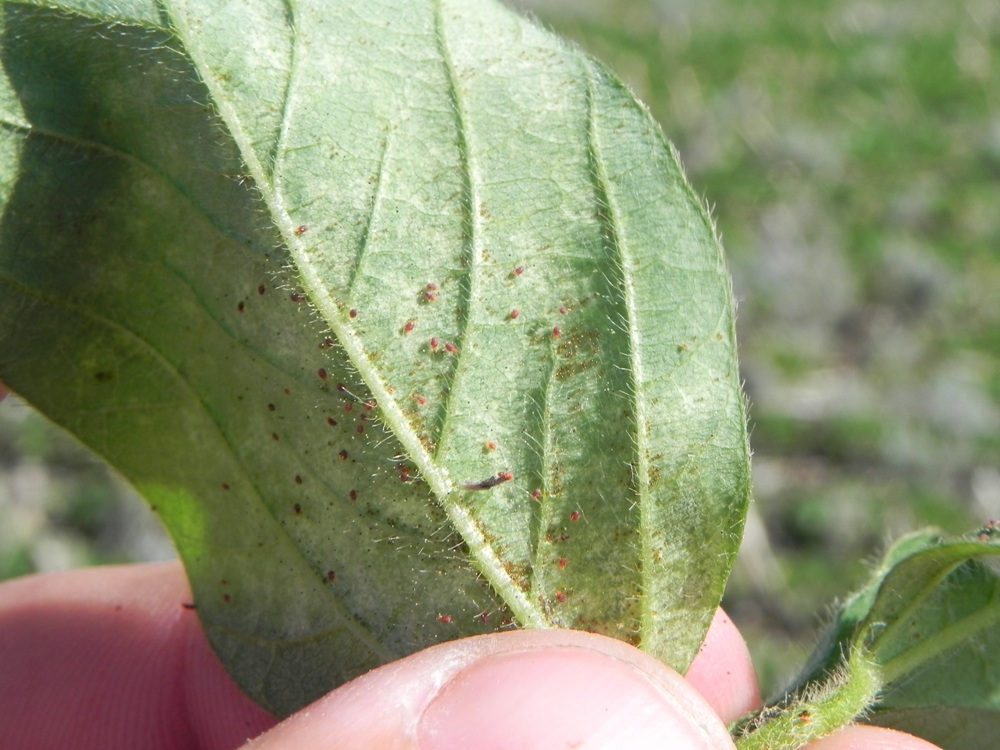

Press Enter to continue...
tetranychus urticae/123.1410c4f1-3e21-4bdc-905e-c31e45b44466.jpg


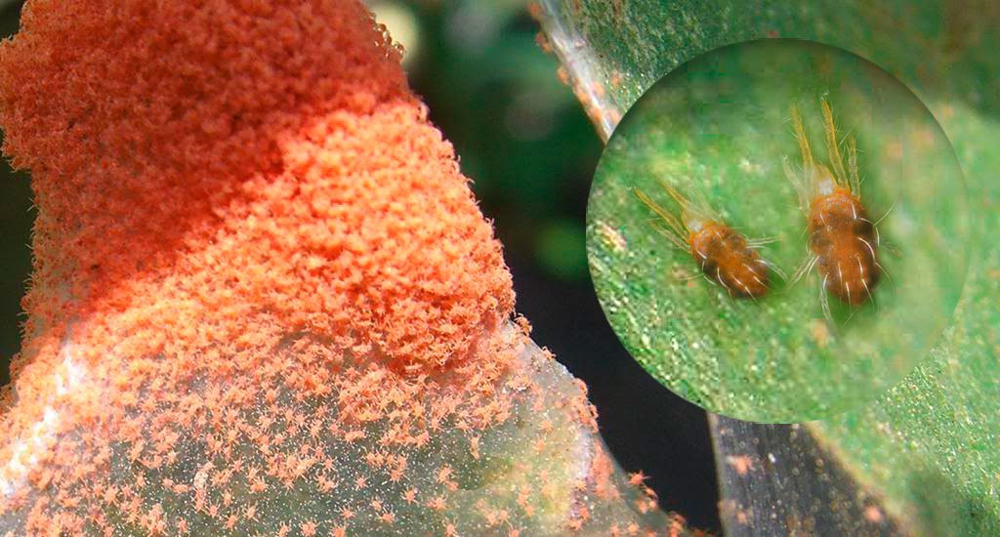

Press Enter to continue...
tetranychus urticae/136.Tetranychus-urticae--02-abr-2014--La-Plata.jpg


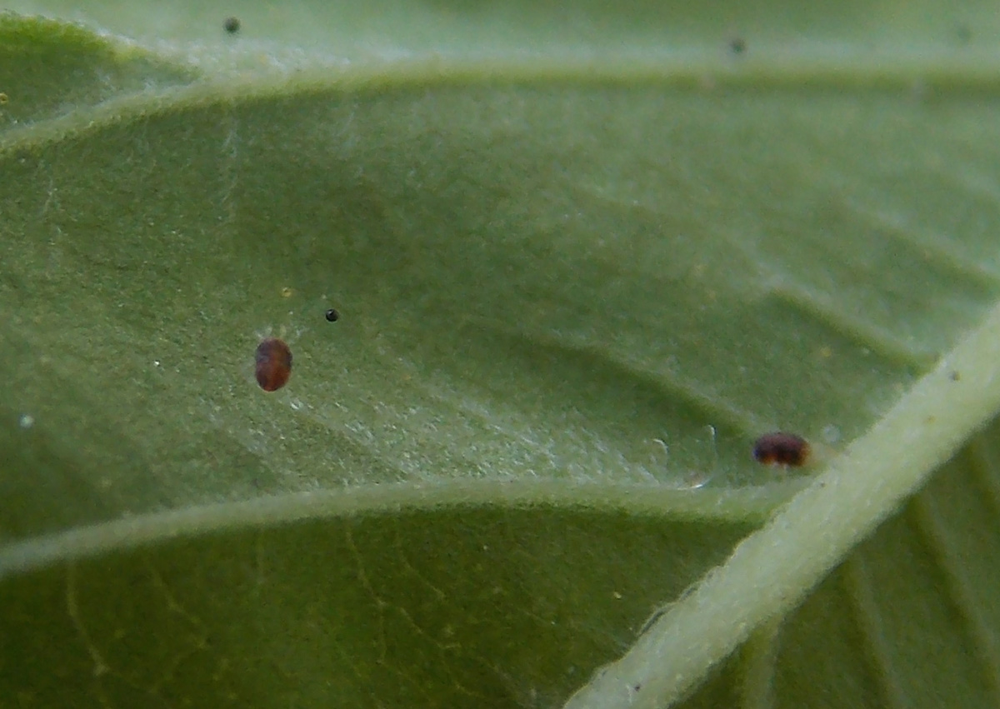

Press Enter to continue...
tetranychus urticae/100.maxresdefault.jpg


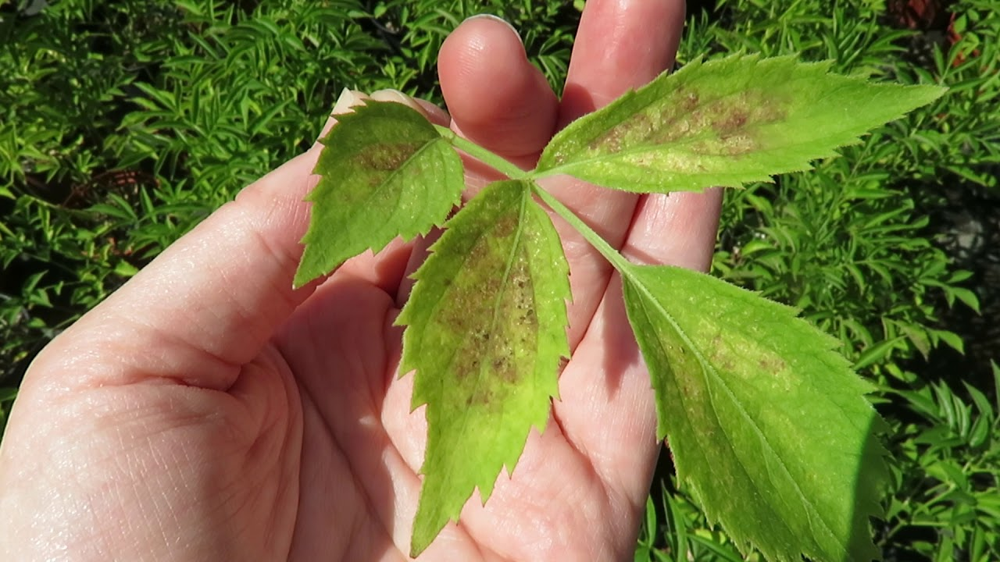

Press Enter to continue...
tetranychus urticae/121.VQZSAQJ0UQ30UQ307K304QWKSKPKLKEK0KCK9QBK9QY05KBKIKHS6QV06Q2KQKWKSKA0LK9KSKC06QRS.jpg


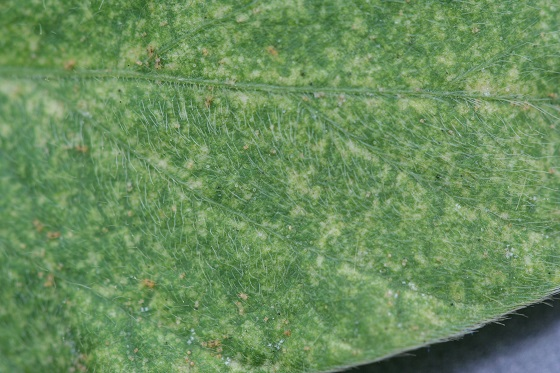

Press Enter to continue...
bemisia tabaci/126.mosca12.jpg


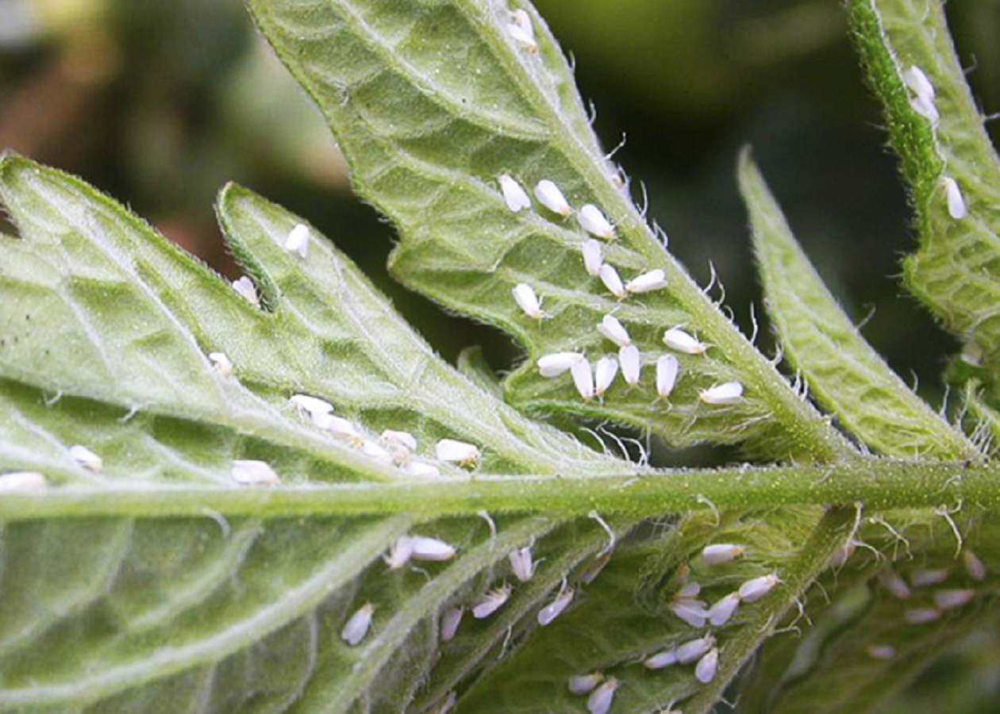

Press Enter to continue...
tetranychus urticae/135.close-up-colony-spiter-mites-tetranychus-urticae-young-poplar-leaf-white-background-116284139.jpg


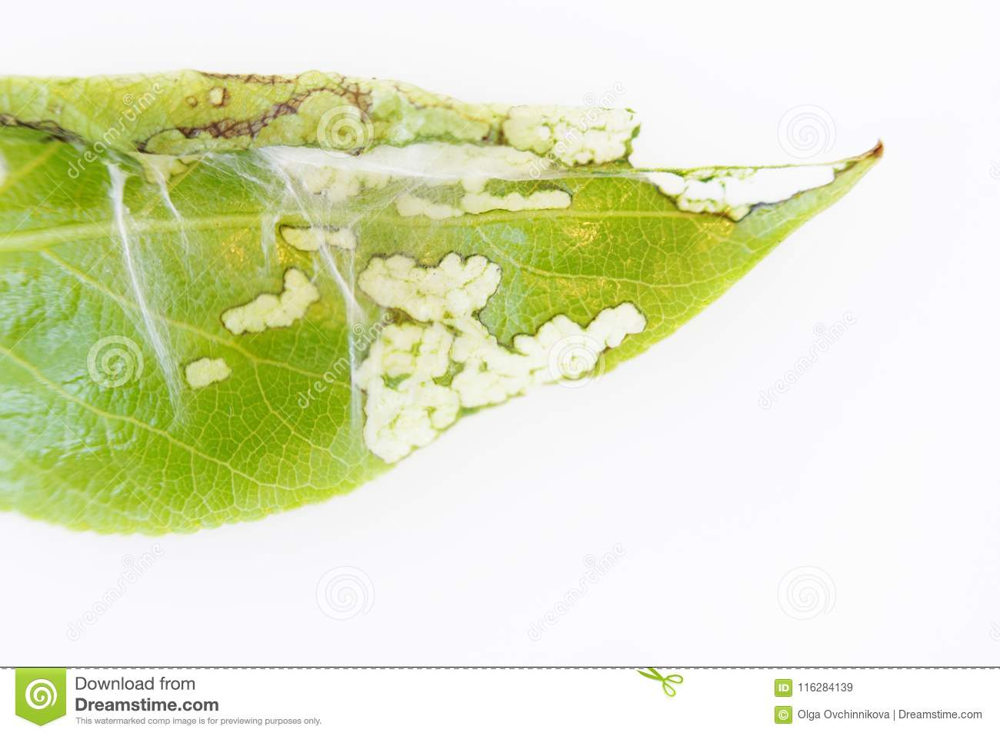

Press Enter to continue...
tetranychus urticae/109.5528458.jpg


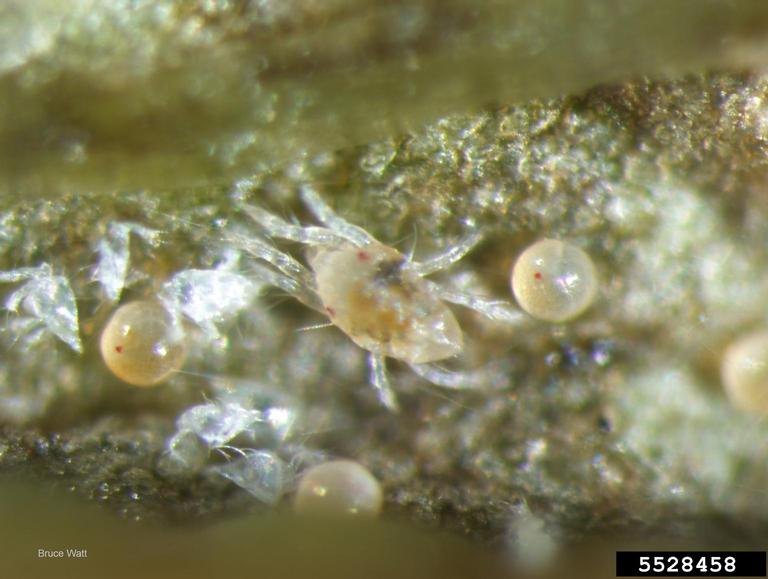

Press Enter to continue...
bemisia tabaci/102.Bemisiatabaci_Fig05sm.jpg


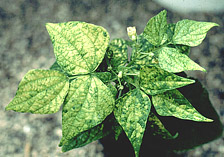

Press Enter to continue...
tetranychus urticae/132.1417141285_araniuelas-tetranychus-urticae.jpg


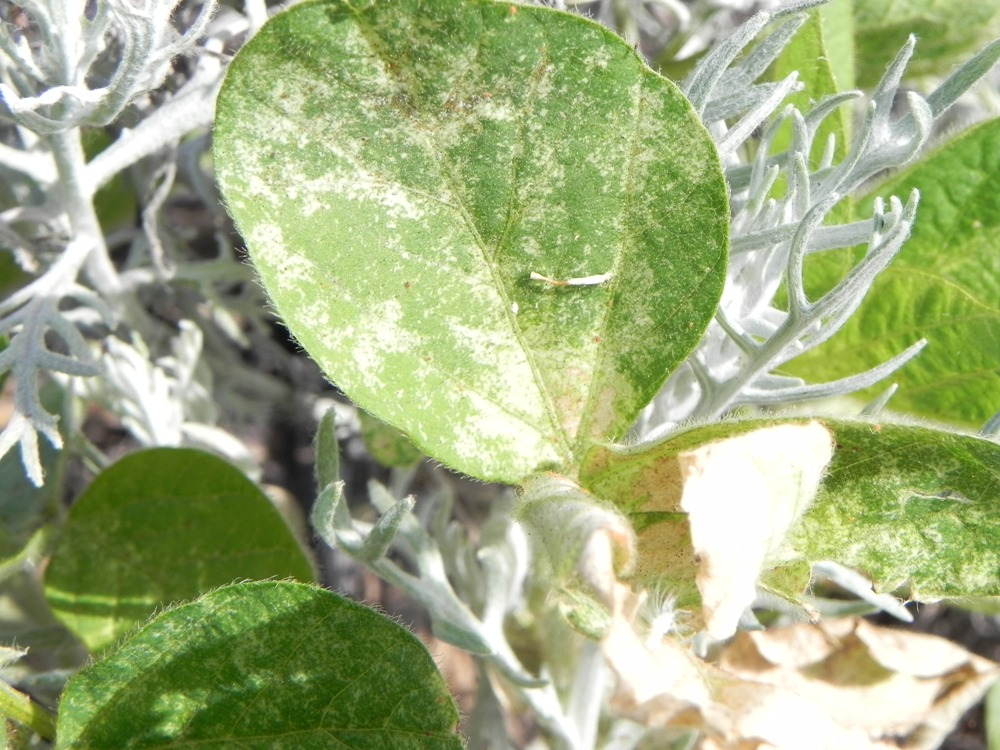

Press Enter to continue...
tetranychus urticae/118.tetranychus-urticae-tetranychidae-red-spider-450w-1163358361.jpg


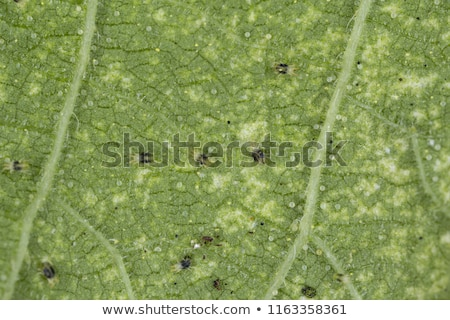

Press Enter to continue...
tetranychus urticae/115.1954140.jpeg


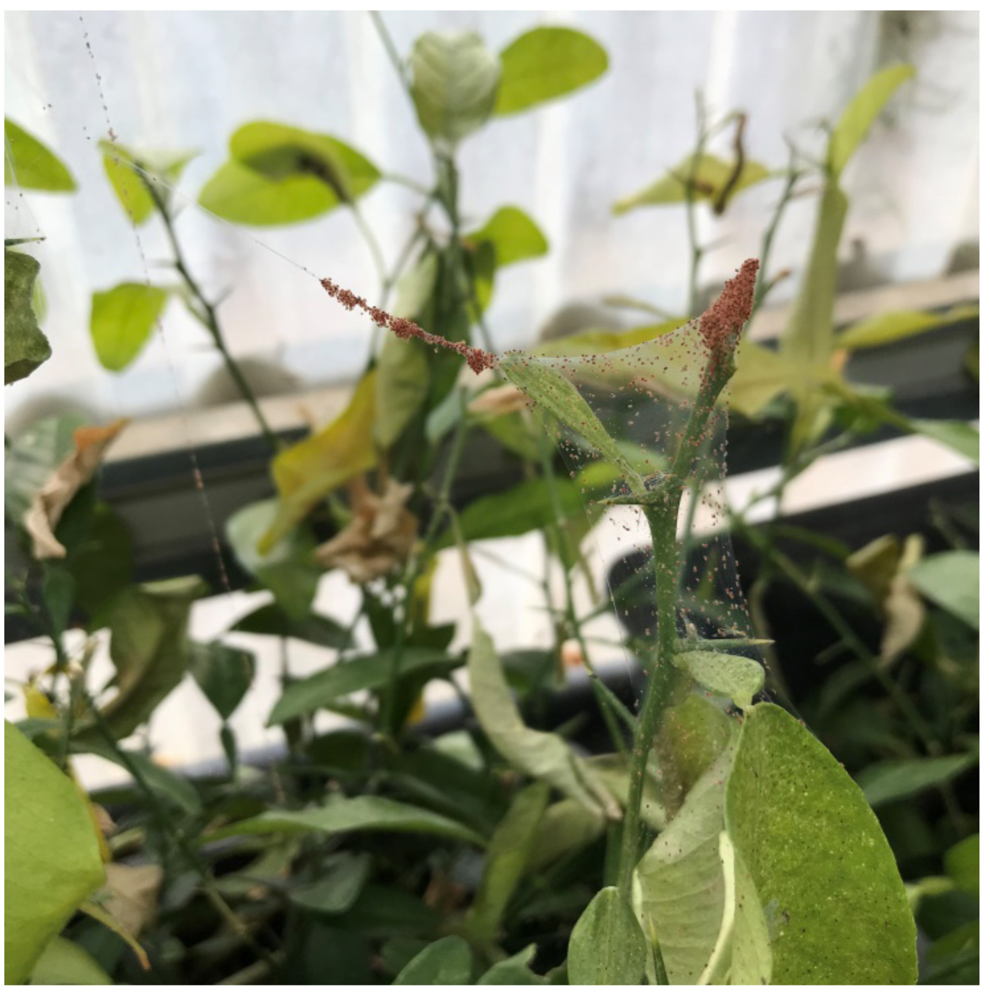

Press Enter to continue...


In [90]:
from IPython.display import Image as ji, display

for sample in wrong_samples:
    print(sample)
    display(ji(filename='./images/' + sample))
    #input("Press Enter to continue...")
#ji(filename='./images/' + wrong_samples[14]) 

bemisia tabaci/121.1024_whiteflies-Large-population-of-B-1024x612.jpg


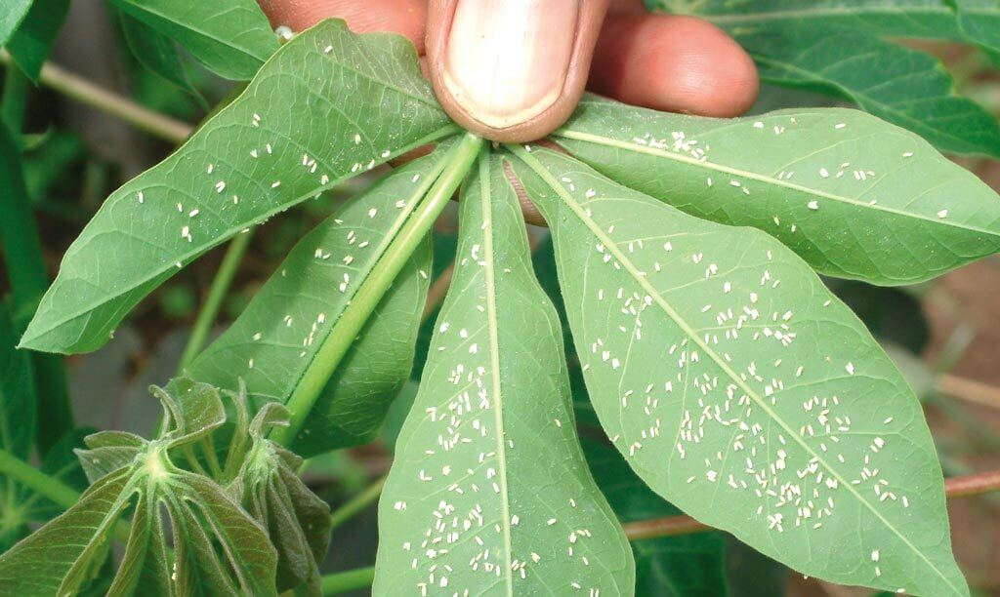

bemisia tabaci/118.Bemisia-tabaci-568958.jpg


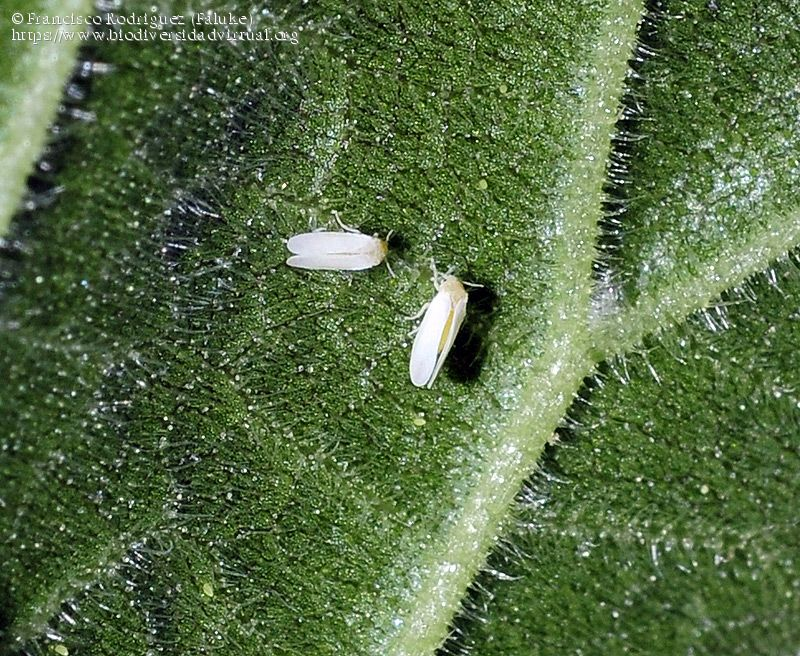

tetranychus urticae/116.5-Ficha-Tetranichus-1.jpg


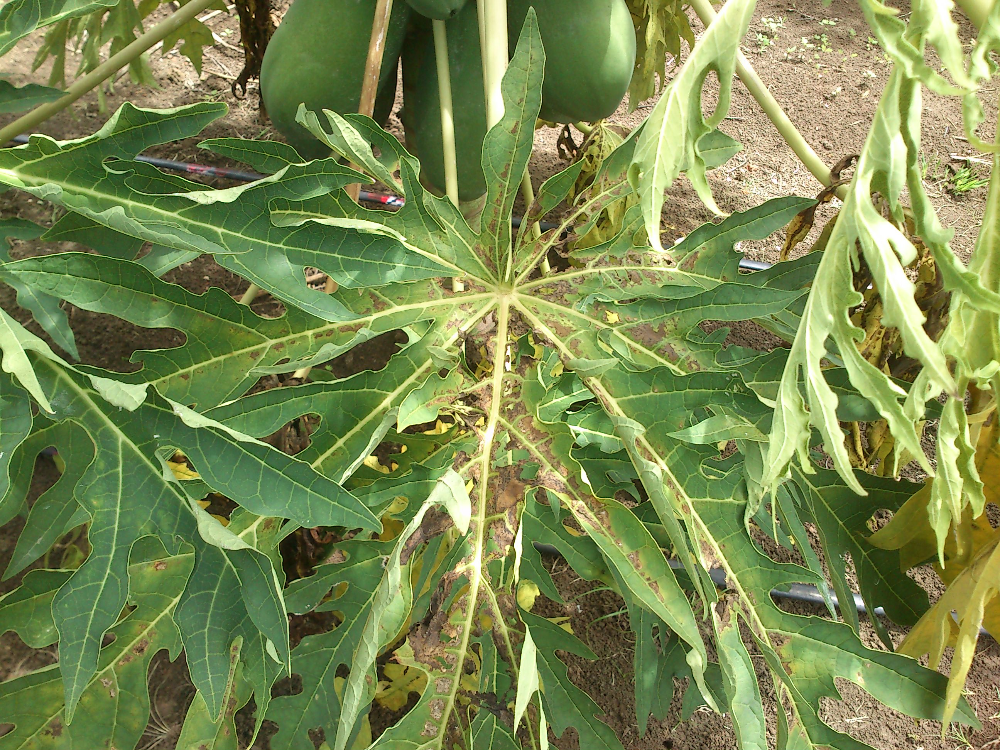

bemisia tabaci/126.mosca12.jpg


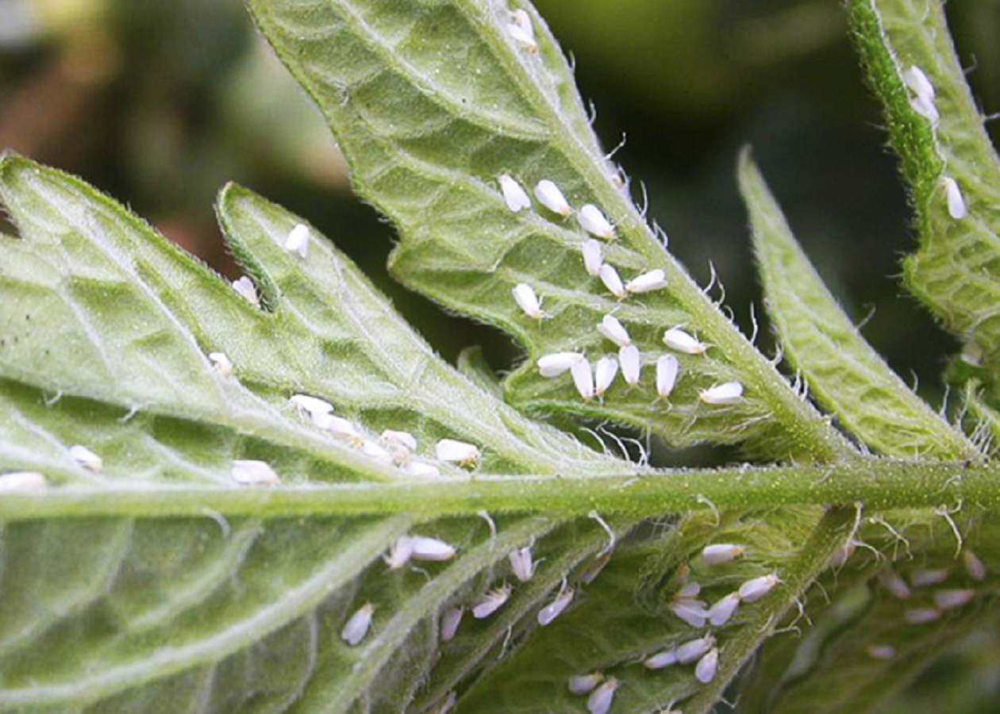

tetranychus urticae/11.Tetranychus_urticae_with_silk_threads.jpg


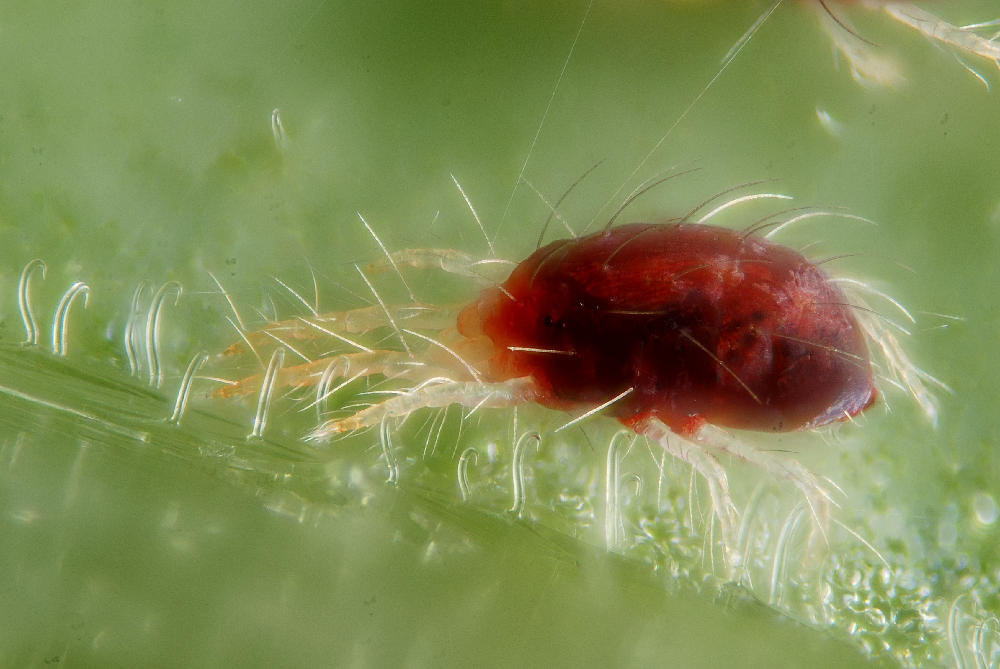

tetranychus urticae/152.472px-Tetranychus-urticae.jpg


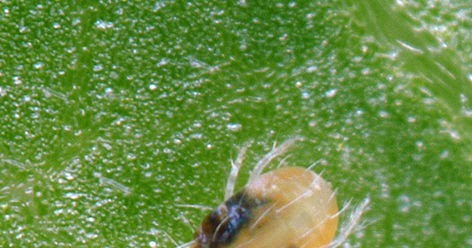

tetranychus urticae/117.foto11.jpg


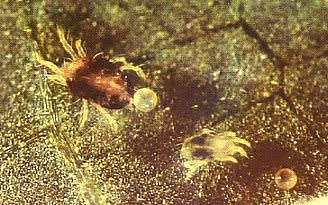

bemisia tabaci/100.3413082.jpg


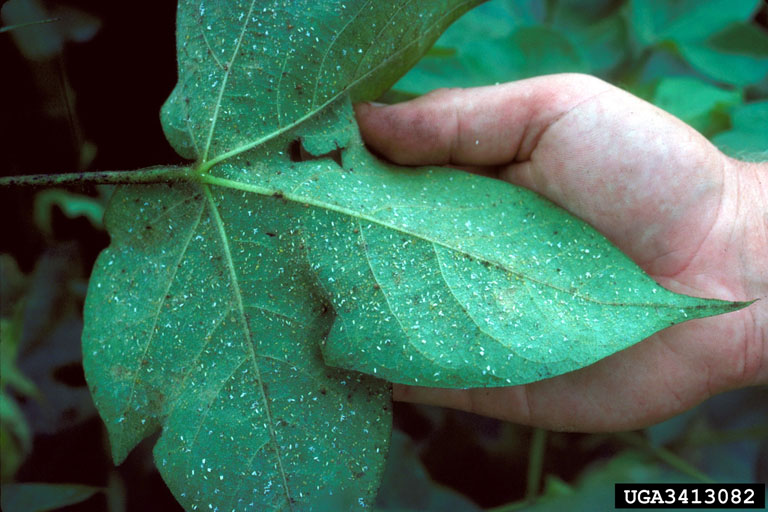

bemisia tabaci/130.copulate.jpg


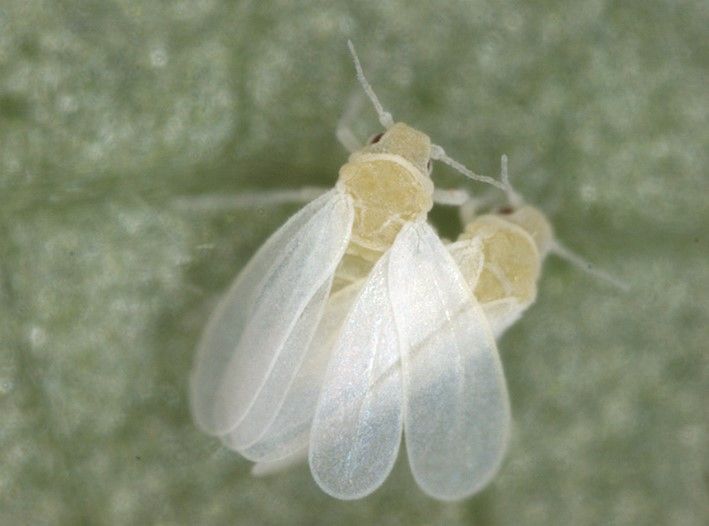

bemisia tabaci/129.165wh.jpg


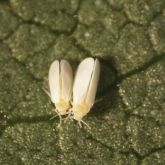

tetranychus urticae/111.92a5da17dfa5c215092b9a2e4dde1882.jpg


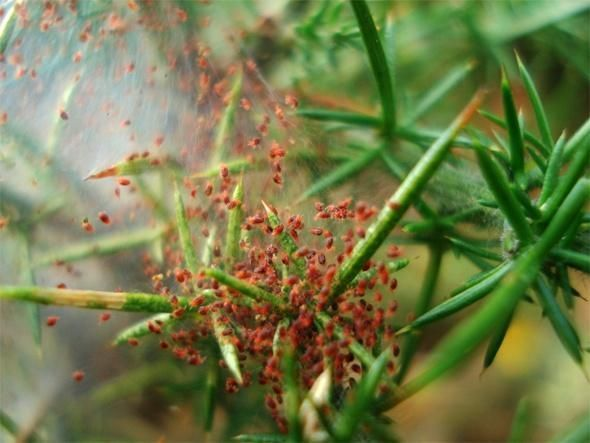

tetranychus urticae/124.Figura-13-Adultos-del-acaro-Tetranychus-urticae-en-hojas-de-gulupa-Foto-John-Ocampo.png


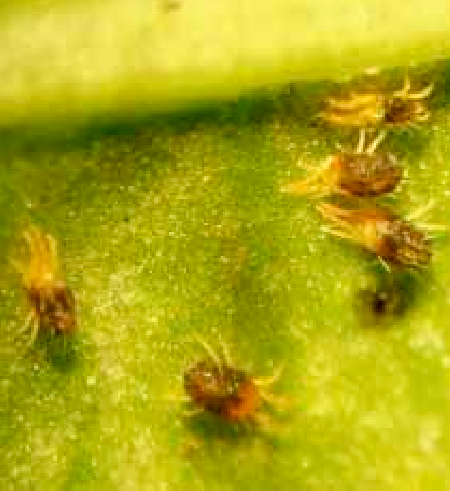

bemisia tabaci/106.mosca-blanca.jpg


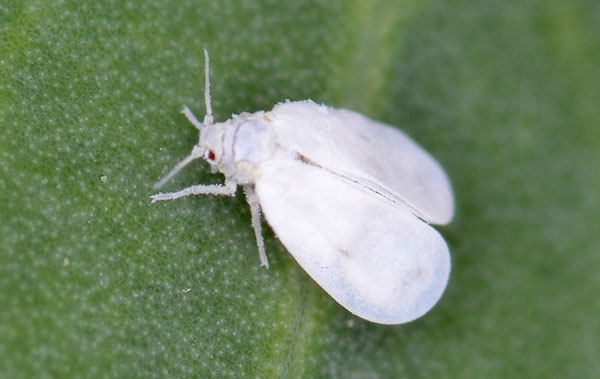

bemisia tabaci/111.Hemiptera-Sternorrhyncha-Aleyrodidae-Bemisia-tabaci-Sweetpotato-Whitefly-B.jpg


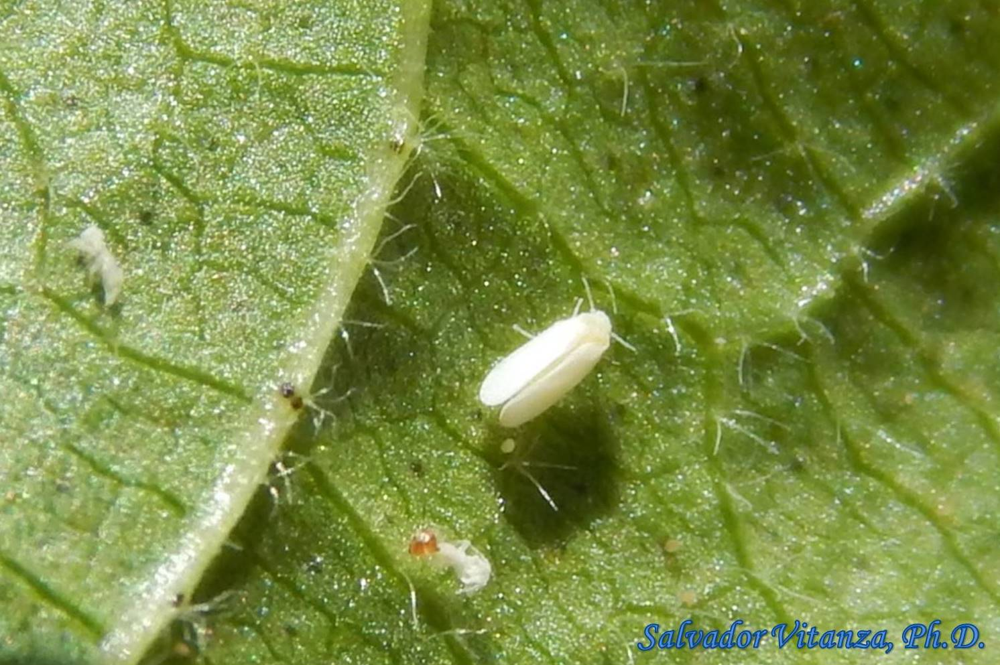

tetranychus urticae/138.2962238560_739722d1df_z.jpg


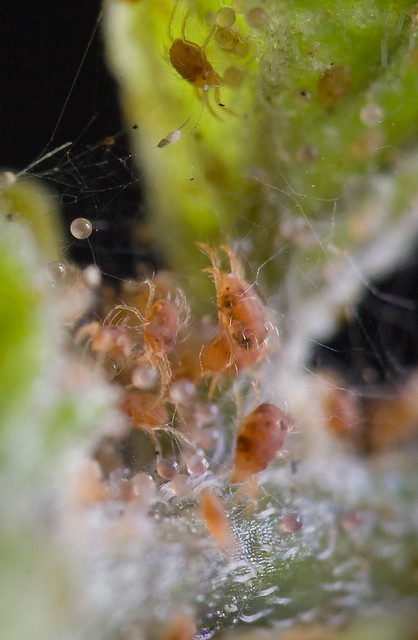

bemisia tabaci/101.Bemisia-tabaci-828544.jpg


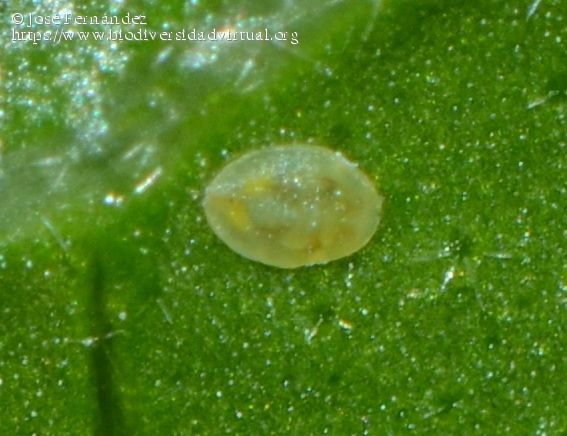

tetranychus urticae/148.6c8fbbfa8b64e5d9a0212a148d228d7d.jpg


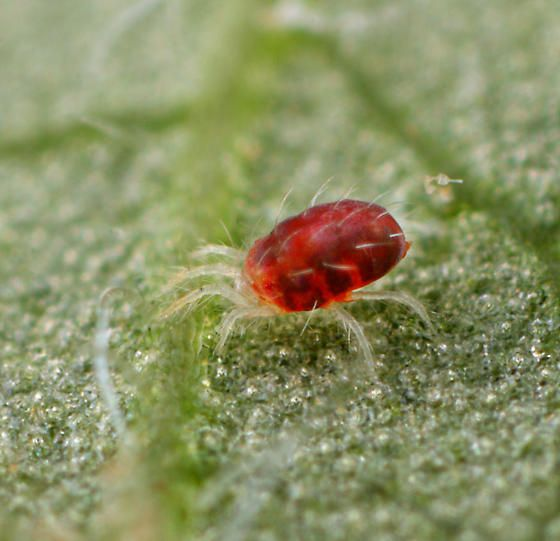

bemisia tabaci/103.6948902583_4223c89921_b.jpg


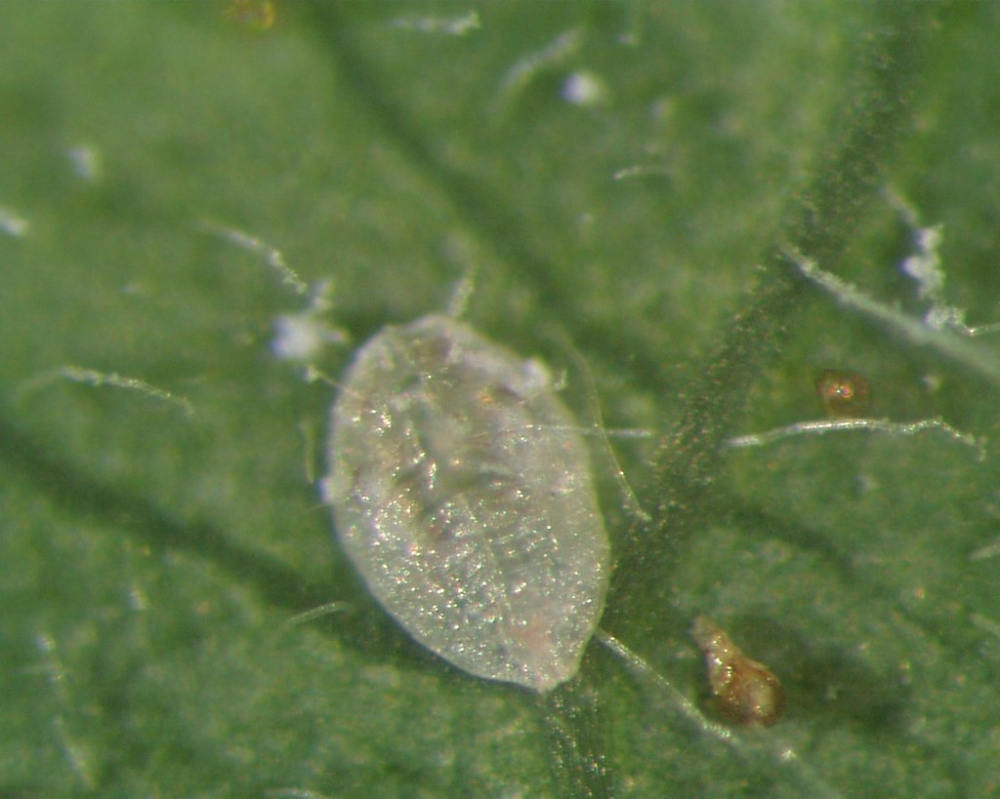

bemisia tabaci/116.Bemisia-tabaci-504171.jpg


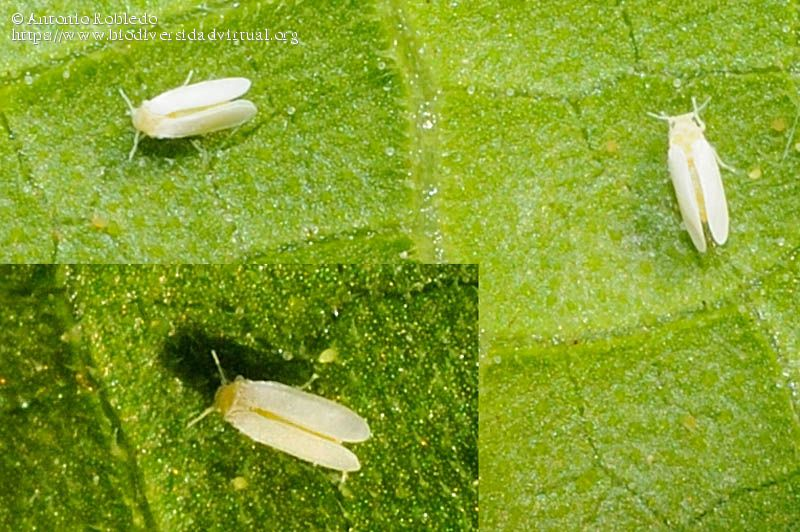

tetranychus urticae/153.Red%20overwintering%20form%20two-spotted%20spider%20mite%20%28Tetranychus%20urticae%29_0.jpg


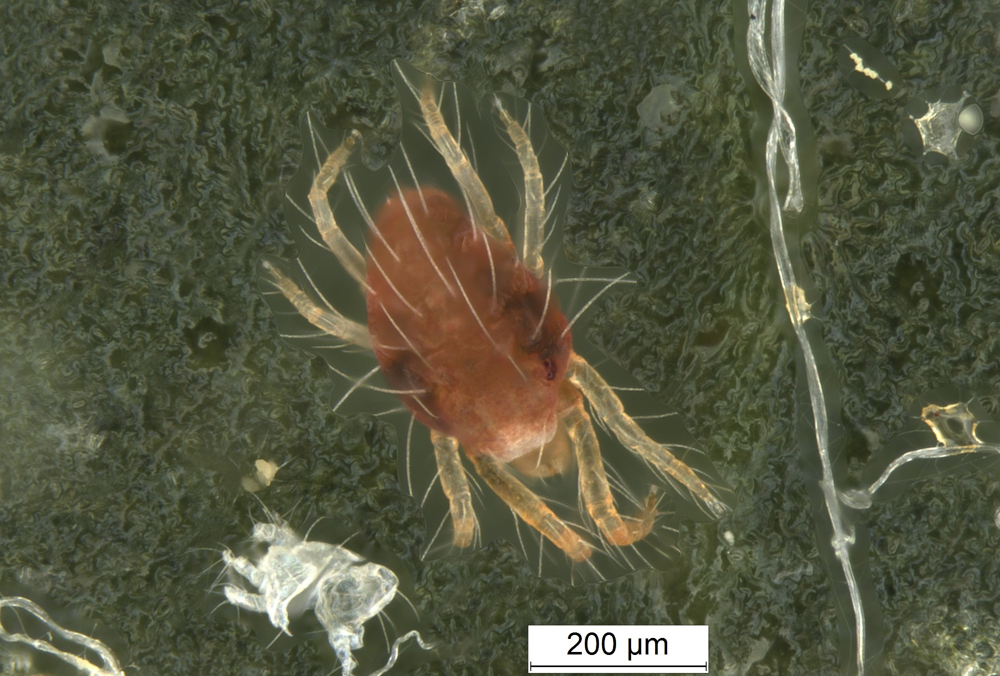

bemisia tabaci/115.Hemiptera-Sternorrhyncha-Aleyrodidae-Bemisia-tabaci-Sweetpotato-Whitefly-D.jpg


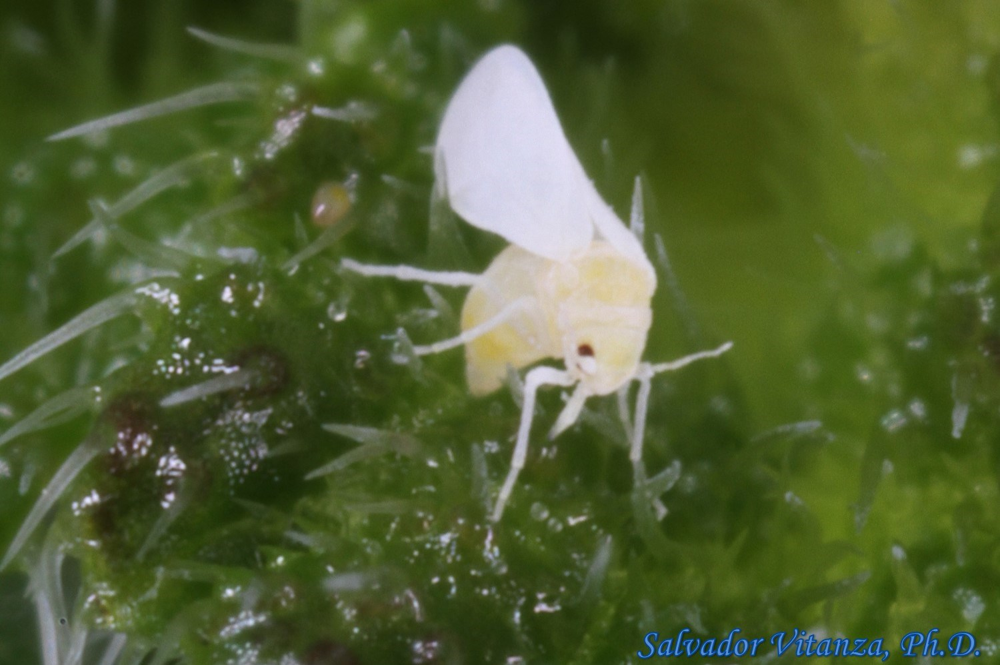

bemisia tabaci/122.2421997156_a65a10d3af_b.jpg


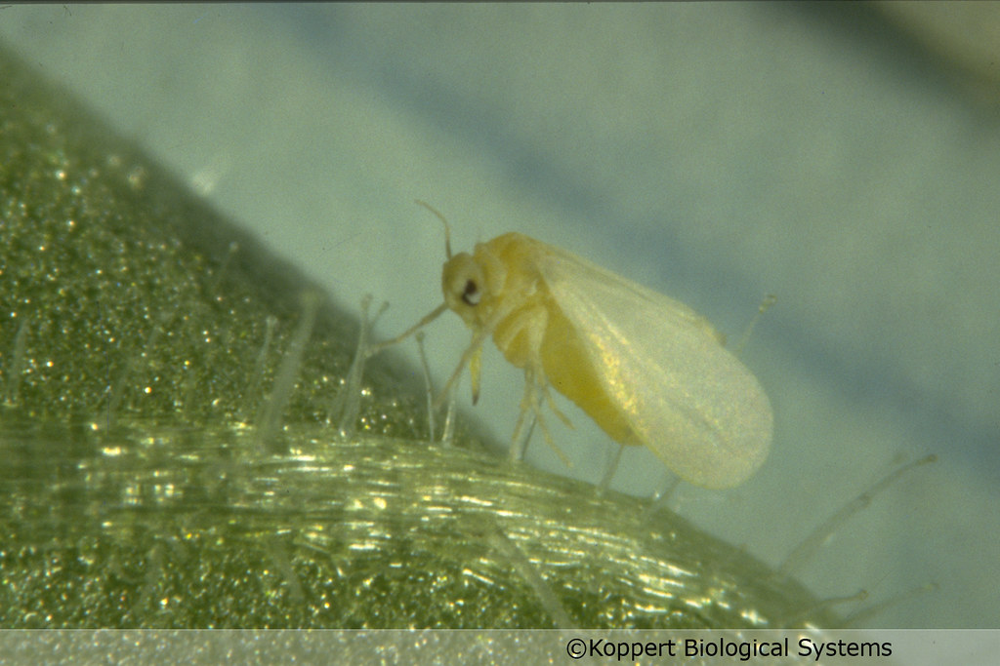

bemisia tabaci/12.926817.jpeg


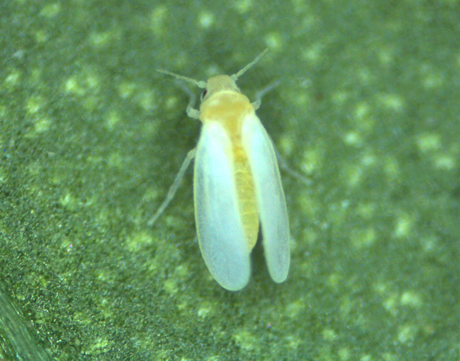

tetranychus urticae/123.1410c4f1-3e21-4bdc-905e-c31e45b44466.jpg


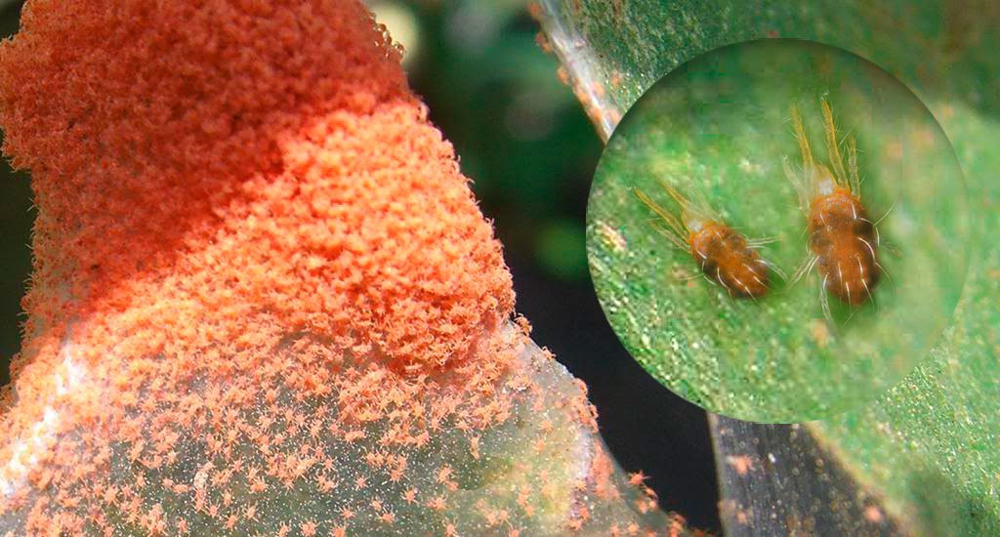

bemisia tabaci/135.8593.jpg


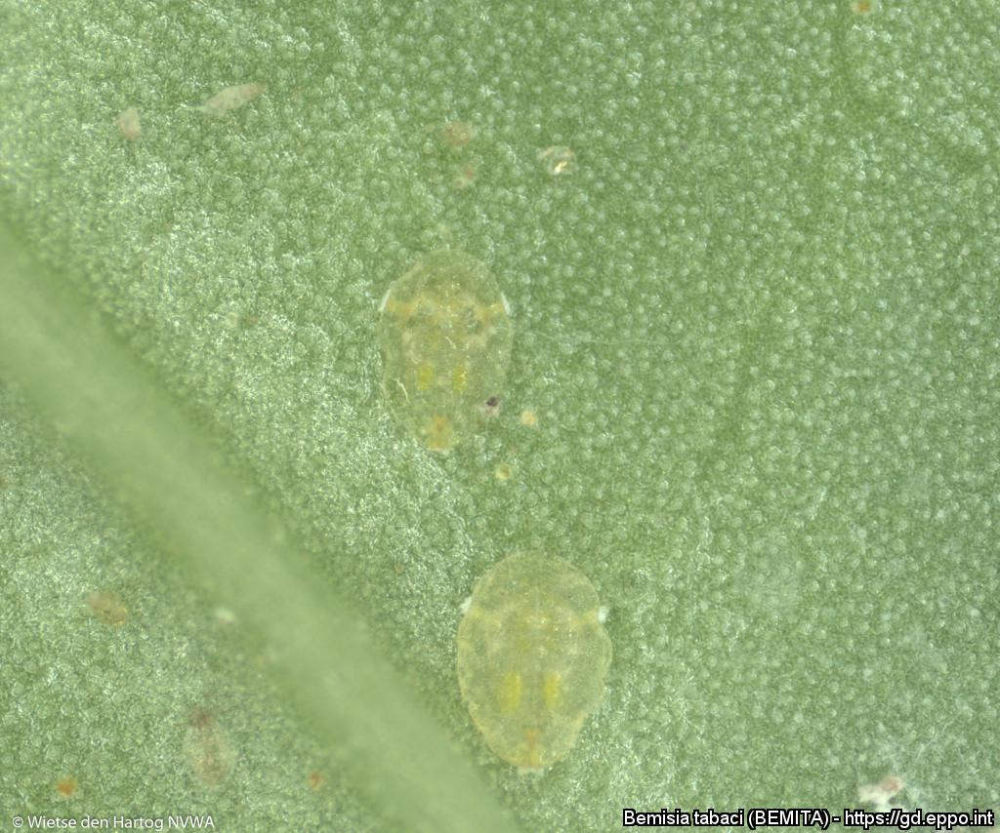

tetranychus urticae/133.Tetranychus_urticae3.jpg


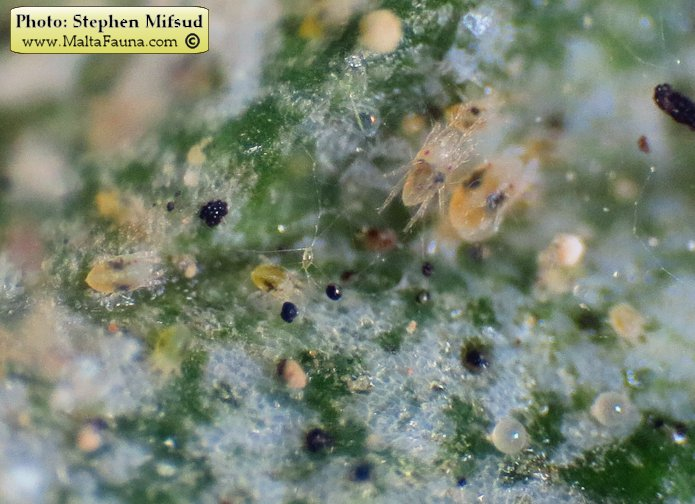

bemisia tabaci/133.Bemisia+tabaci+%25282%2529.jpg


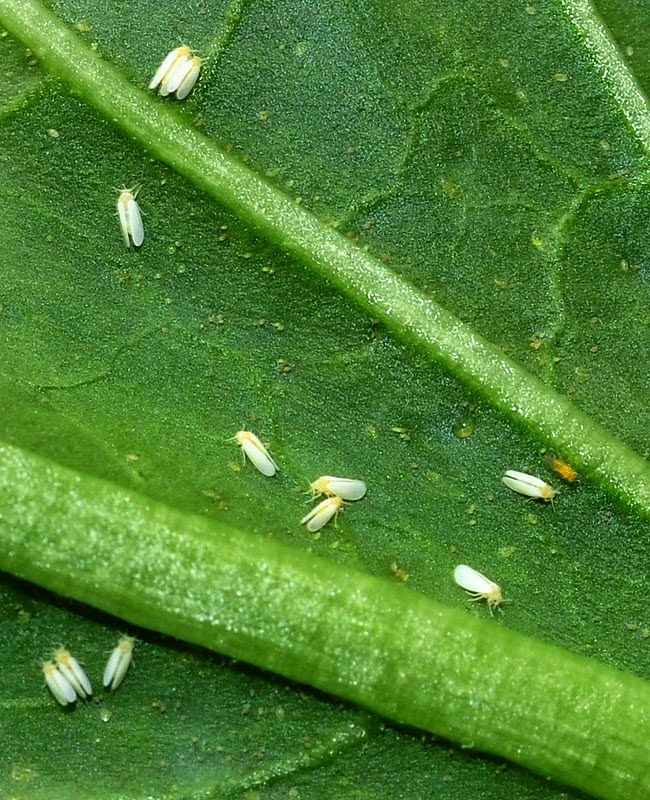

tetranychus urticae/150.IRYZ0RFZGR9LQZCLHZCLHZ6LJLNLQR3Z0RNL3LOZFL6LJLDZ4RRHSRYZYLJZRZDL0ZLH0ZAL8R0HERZH0Z0H8RDL0Z.jpg


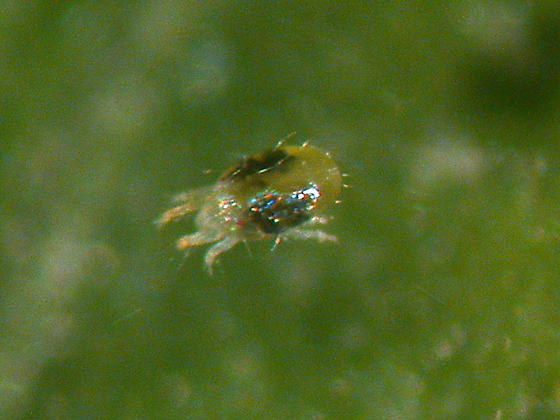

tetranychus urticae/128.hembra-adulta-de-arana-roja-de-los-invernaderos-tetranychus-urticae-en-una-hoja-x5ggwd.jpg


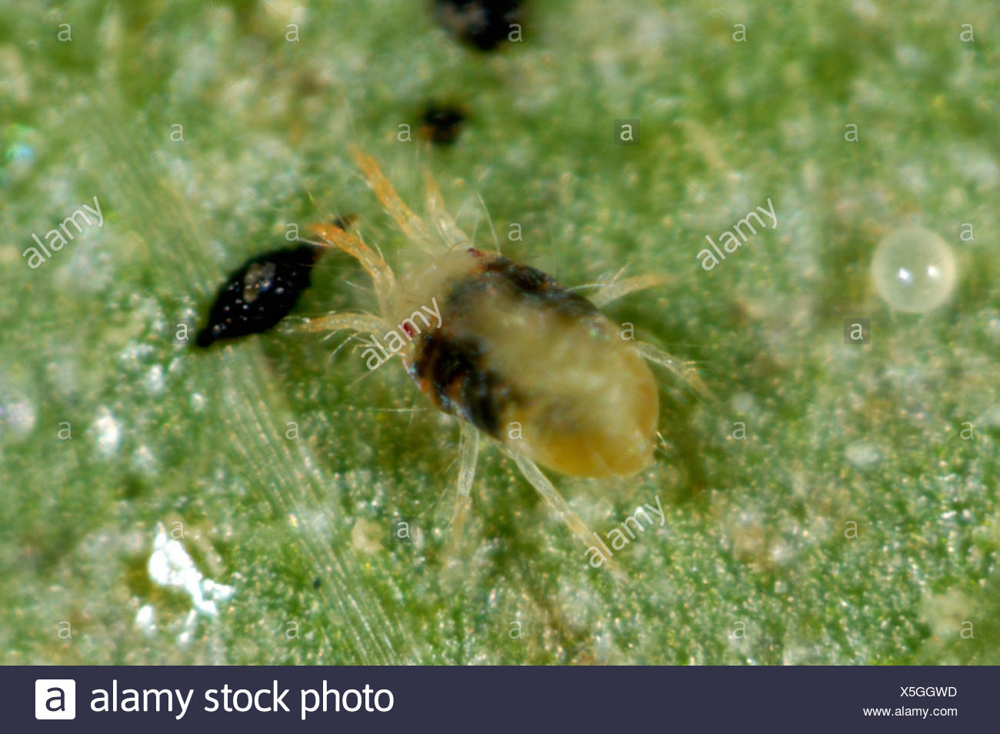

tetranychus urticae/12.Tetranychus-urticae-328973.jpg


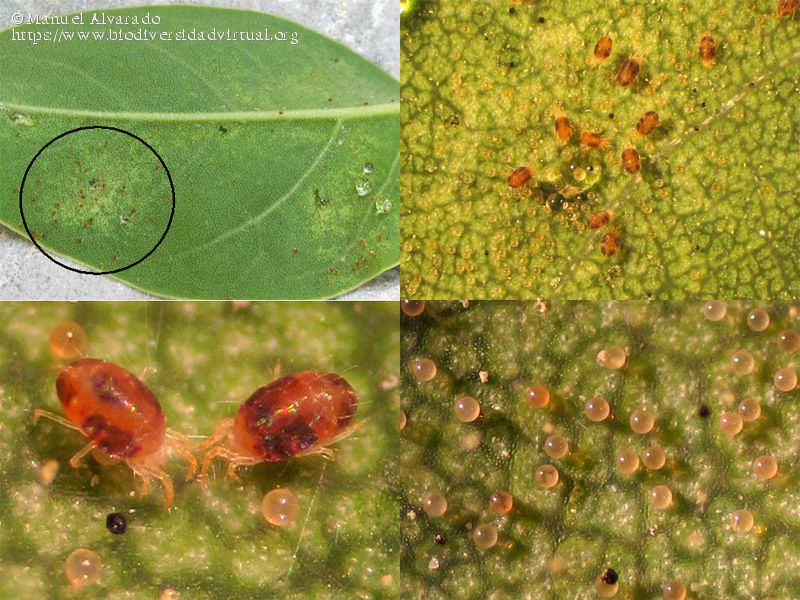

tetranychus urticae/102.Tetranychus-Urticae2-872x310.jpg


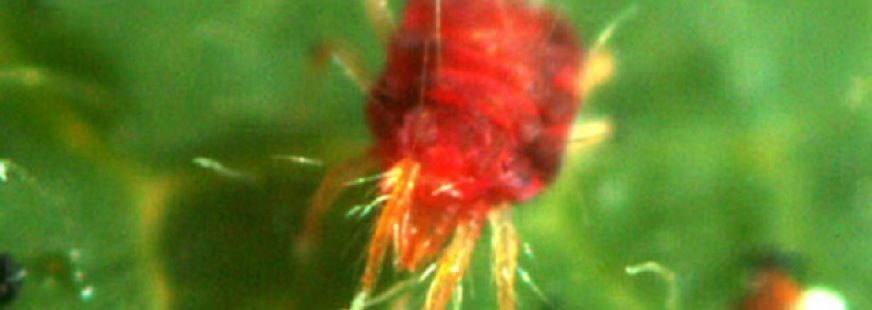

bemisia tabaci/123.Un-probleme-regional-devenu-mondial-l-aleurode-Bemisia-tabaci_article.jpg


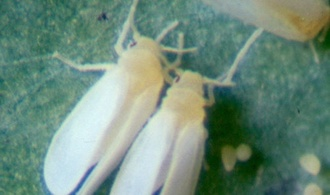

tetranychus urticae/112.Tetranychus-urticae-da%C3%B1os.jpg


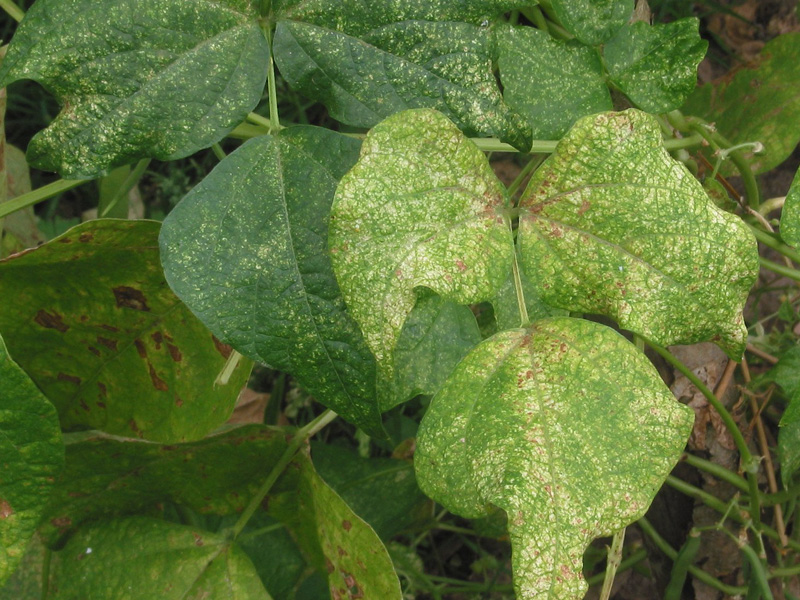

bemisia tabaci/10.Bemisia-tabaci.jpg


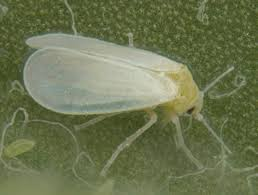

bemisia tabaci/109.Bemisia-tabaci-400840.jpg


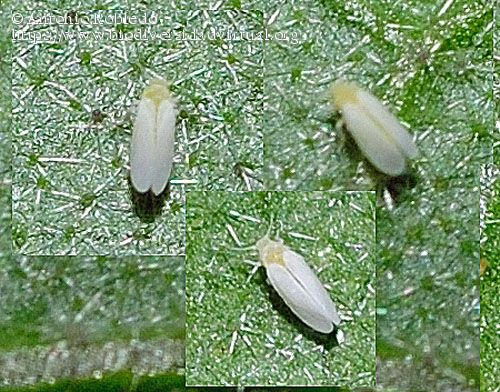

tetranychus urticae/149.aoc3bbt-29.jpg


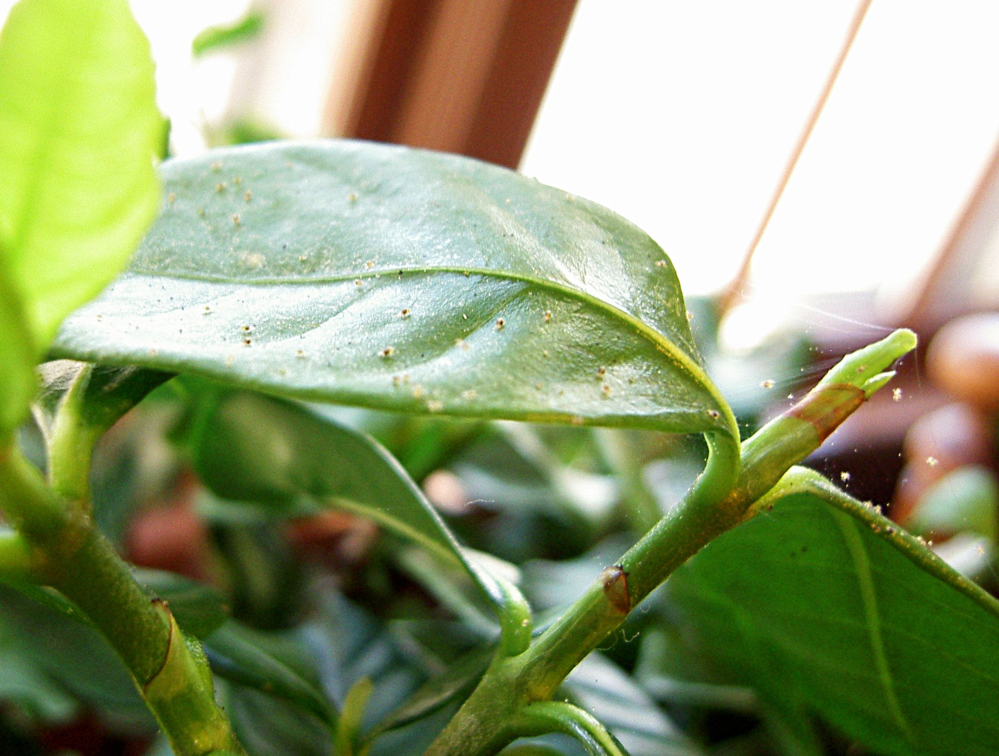

bemisia tabaci/137.2773729345_93022c2170_b.jpg


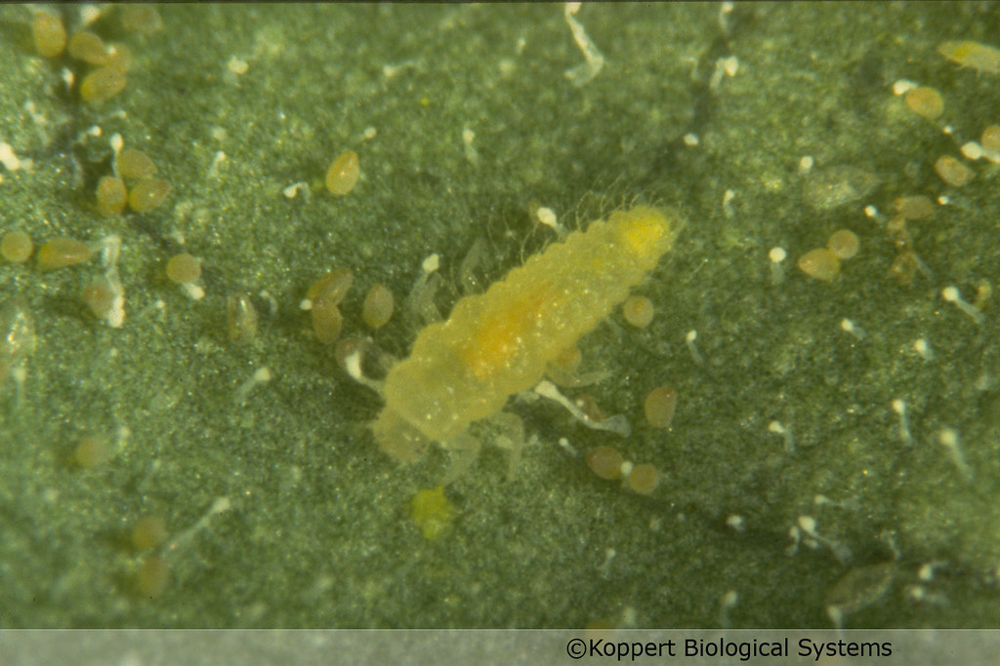

tetranychus urticae/14.Tetranychus-Urticae4-872x310.jpg


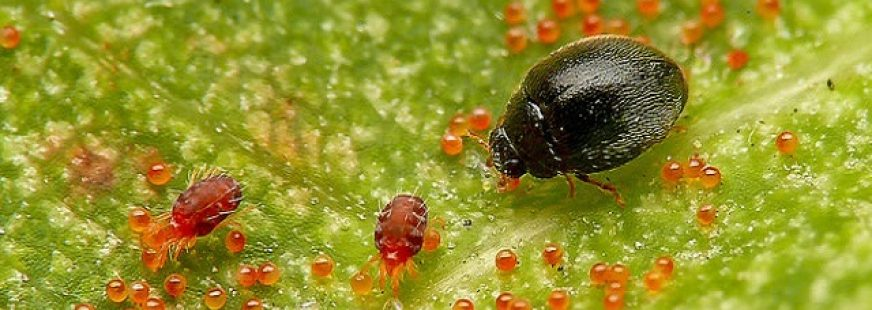

bemisia tabaci/139.Bemisia-tabaci-larva.jpg


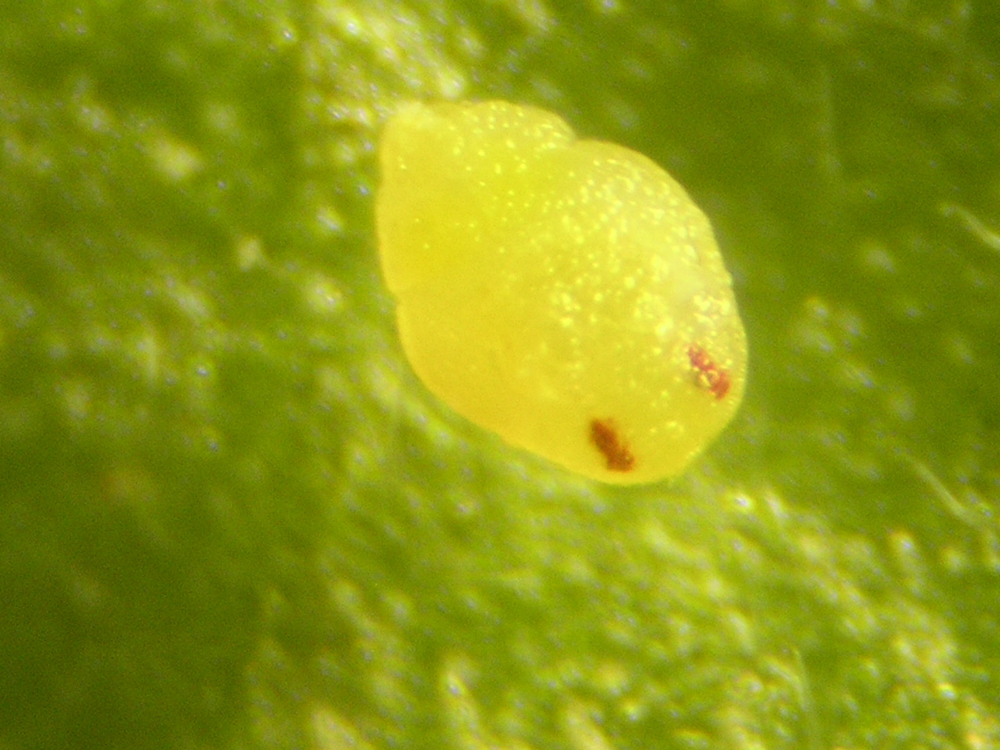

tetranychus urticae/142.tetranychus_urticae.jpg


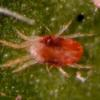

bemisia tabaci/104.0660071.jpg


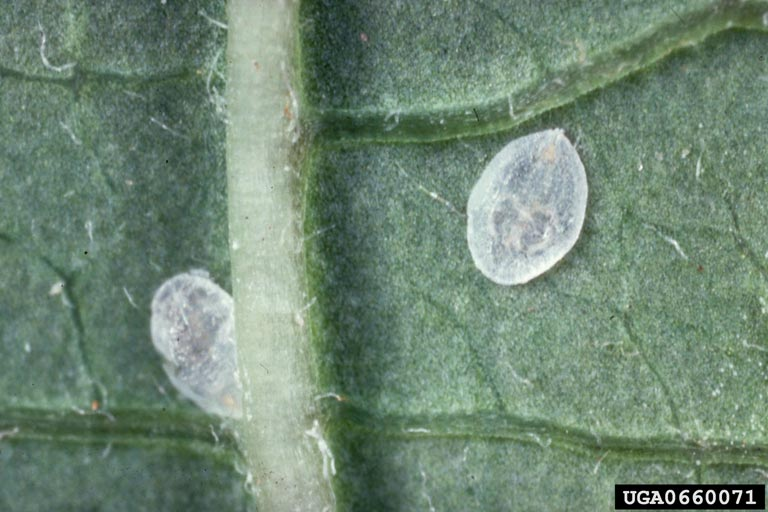

tetranychus urticae/114.mev-10857512.jpg


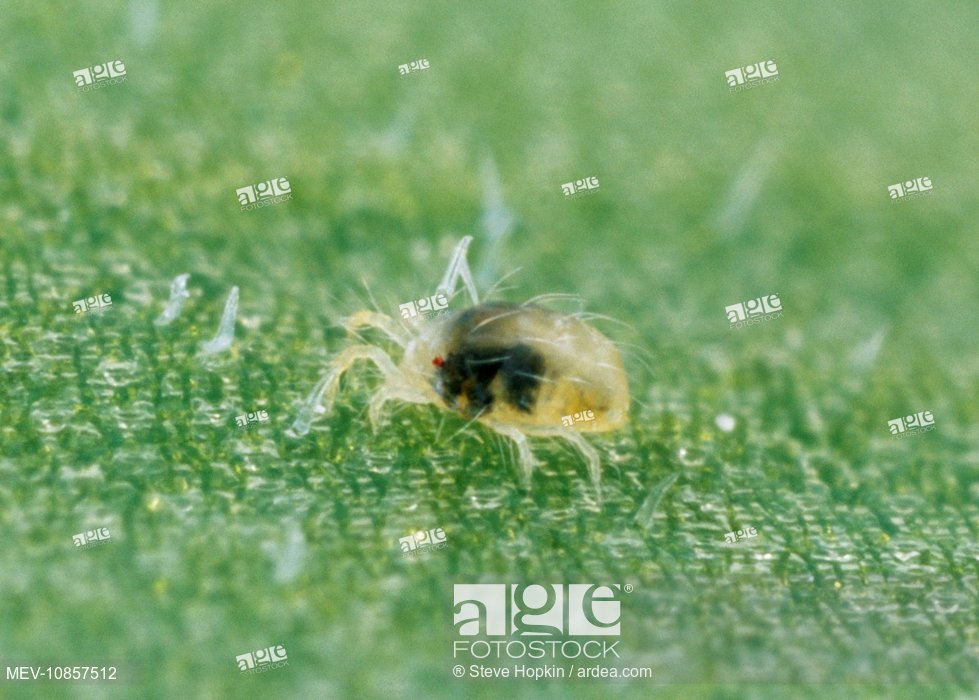

tetranychus urticae/125.Tetranychus_urticae_maybe,I_JOB3942.jpg


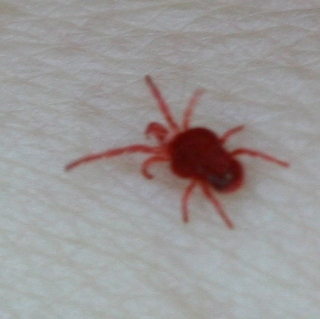

tetranychus urticae/122.la-arana-roja.jpg


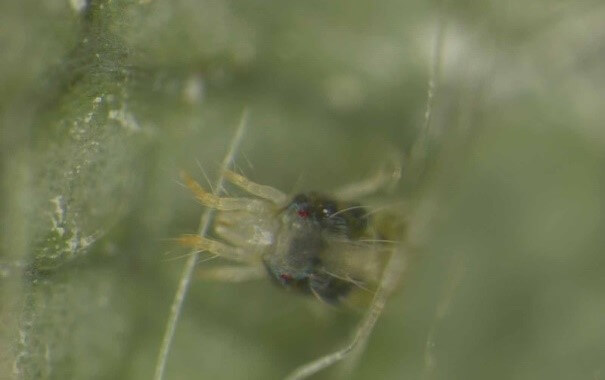

tetranychus urticae/129.5361242.jpg


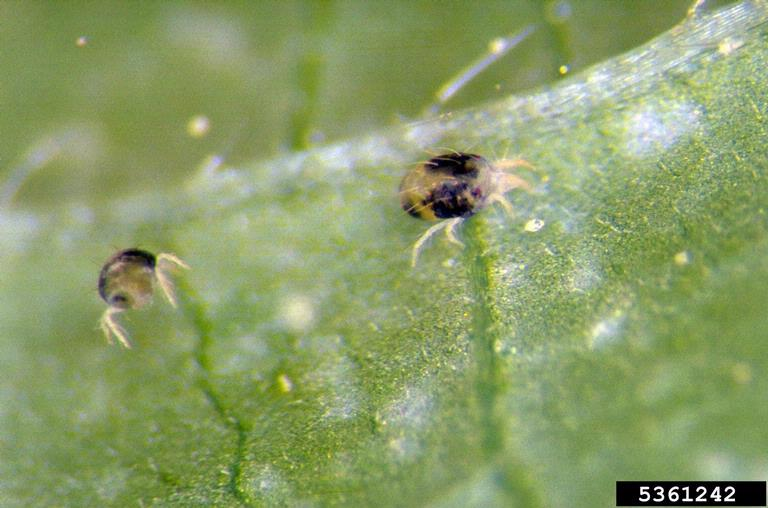

tetranychus urticae/115.1954140.jpeg


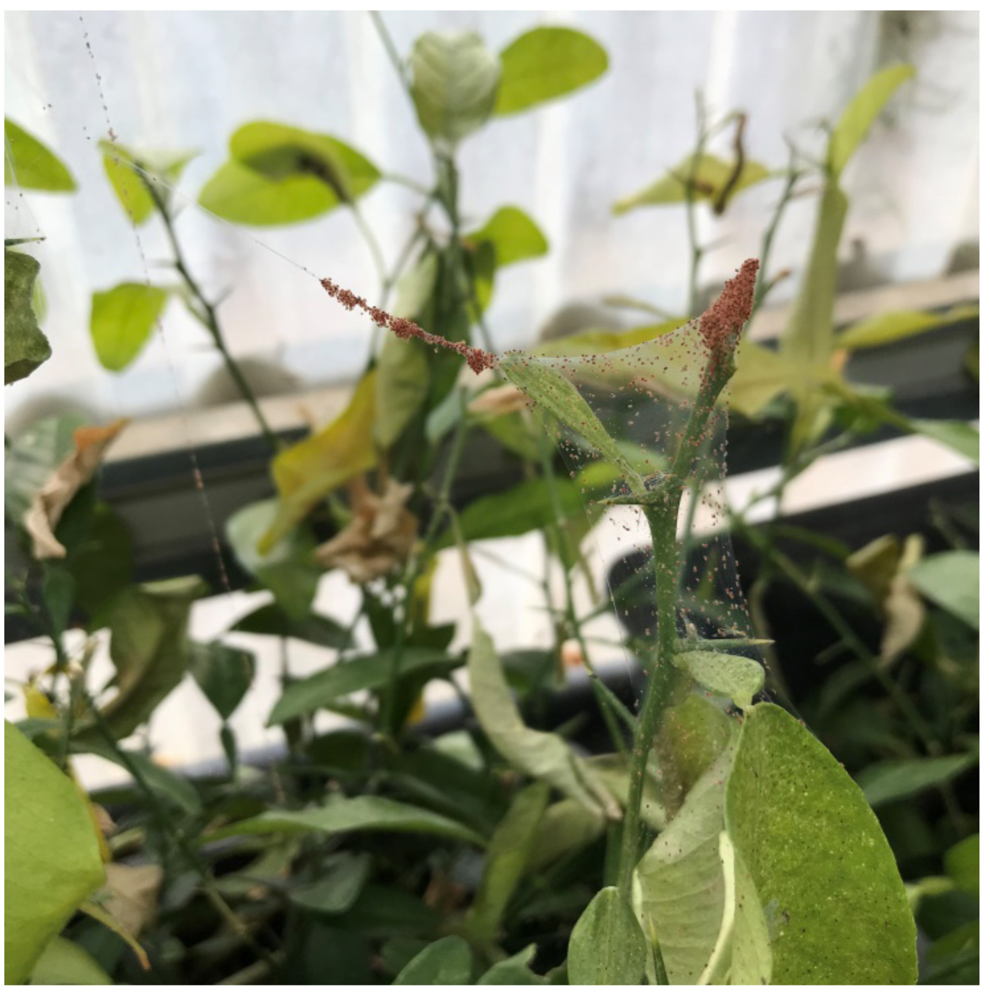

bemisia tabaci/141.mosca-branca.jpg


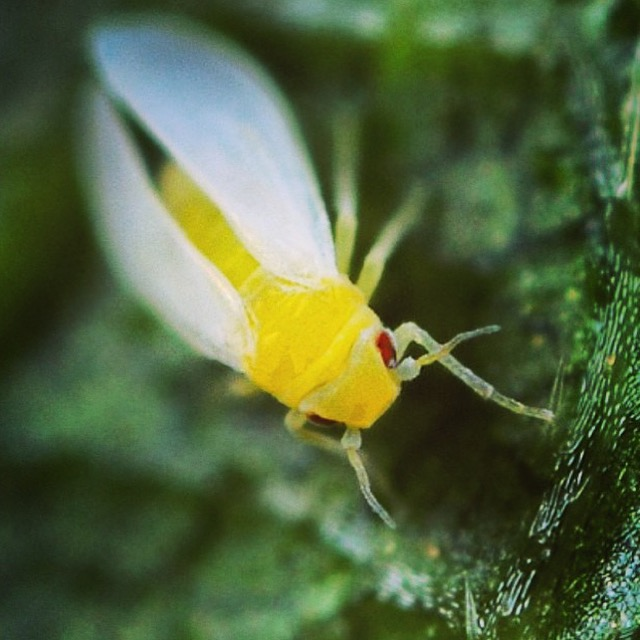

tetranychus urticae/108.arana-roja.jpg


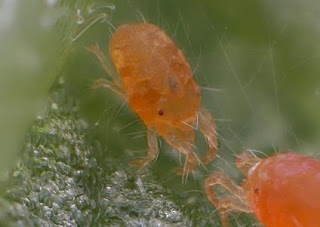

tetranychus urticae/10.A-B-C-Colours-variations-in-active-green-form-GF-females-of-Tetranychus-urticae.png


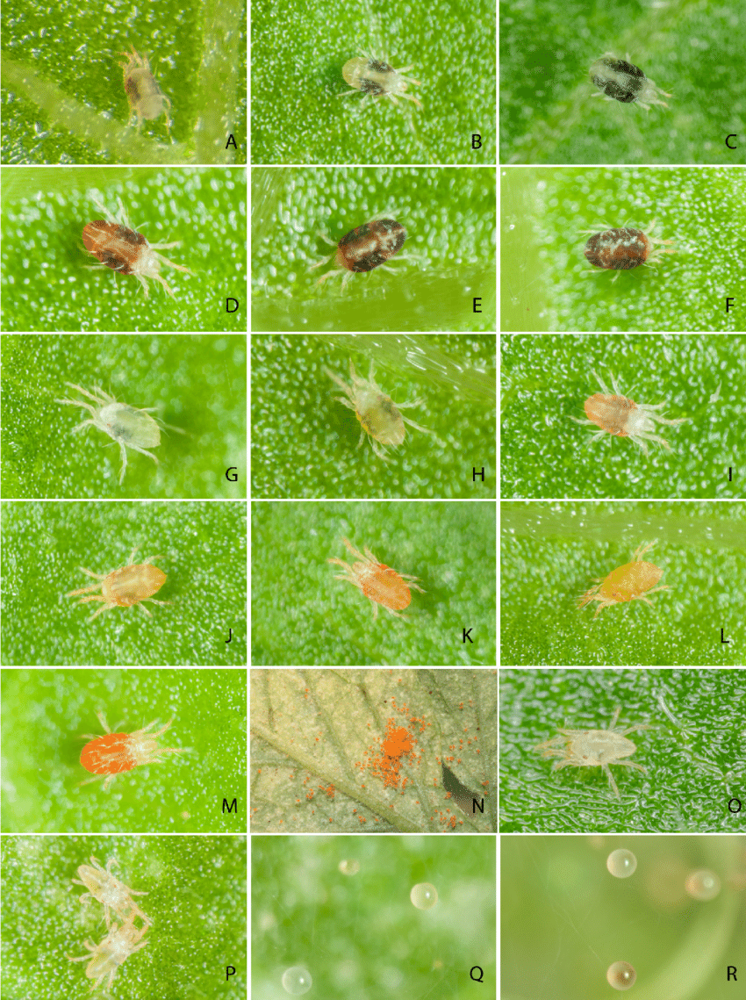

bemisia tabaci/108.insects-08-00025-g001.png


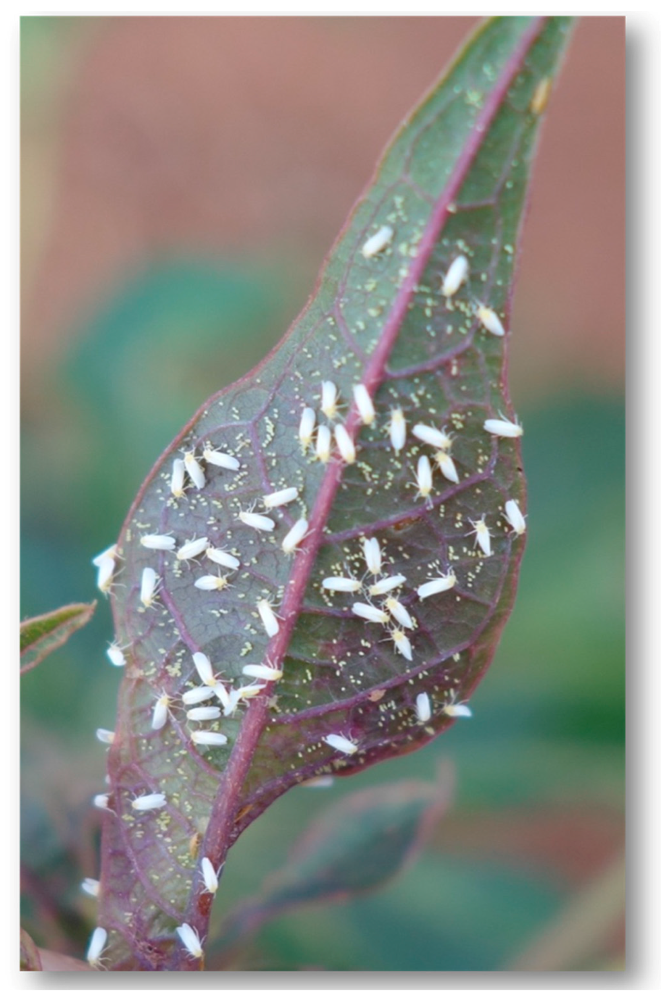

bemisia tabaci/113.2774584678_fb76631d15_b.jpg


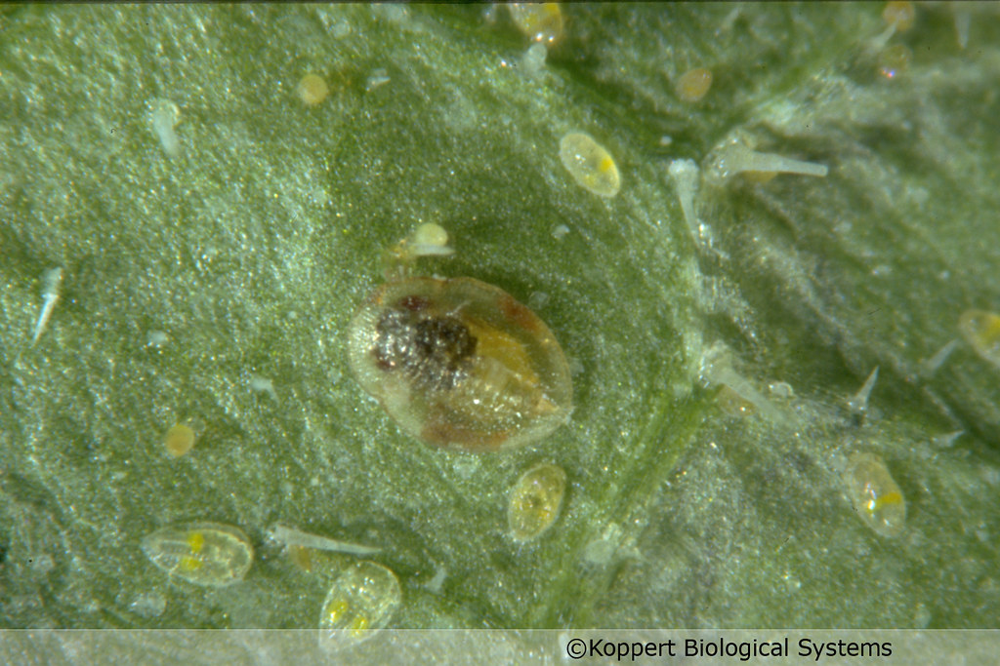

bemisia tabaci/120.Ninfa-de-mosca-blanca-Bemisia-tabaci-Charles-Olsen-USDA-APHIS-PPQ-Bugwood.org_-563x450.jpg


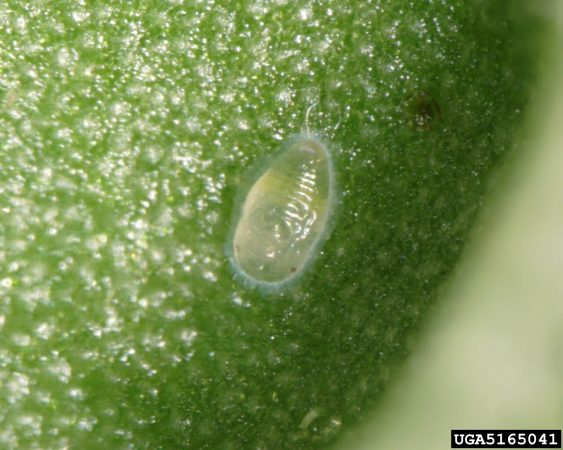

bemisia tabaci/128.silverleaf_whitefly15.JPG


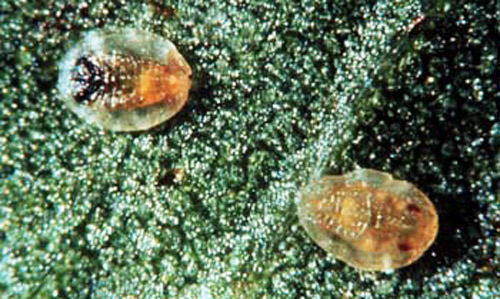

tetranychus urticae/147.Biol421TetranychusurticaeRedandSpotted.png


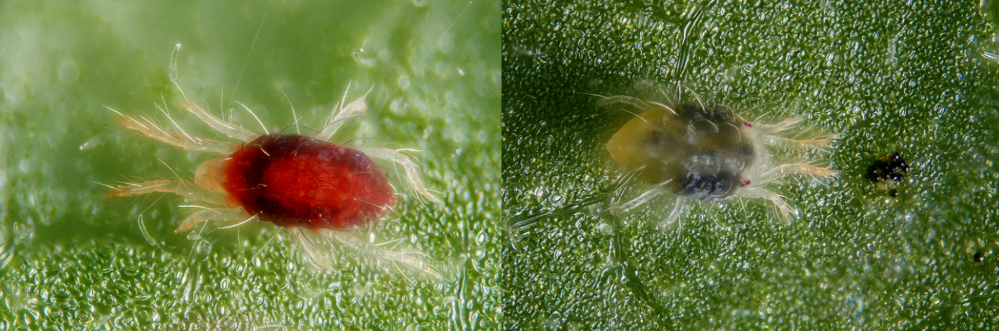

bemisia tabaci/145.2421182159_da881ed1ee_b.jpg


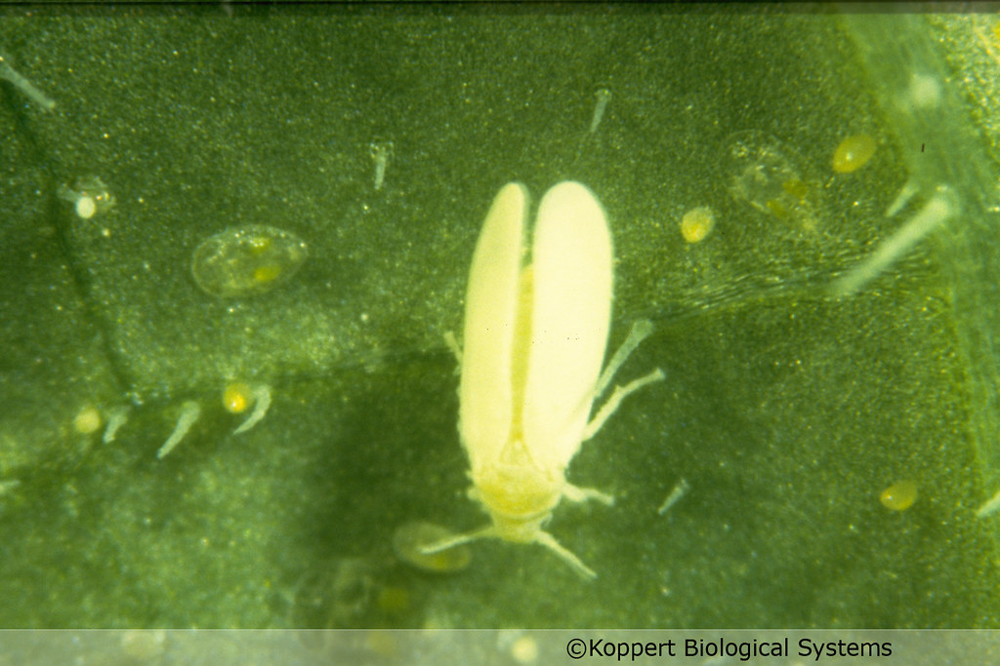

tetranychus urticae/127.Tetranychus-urticae-1029176.jpg


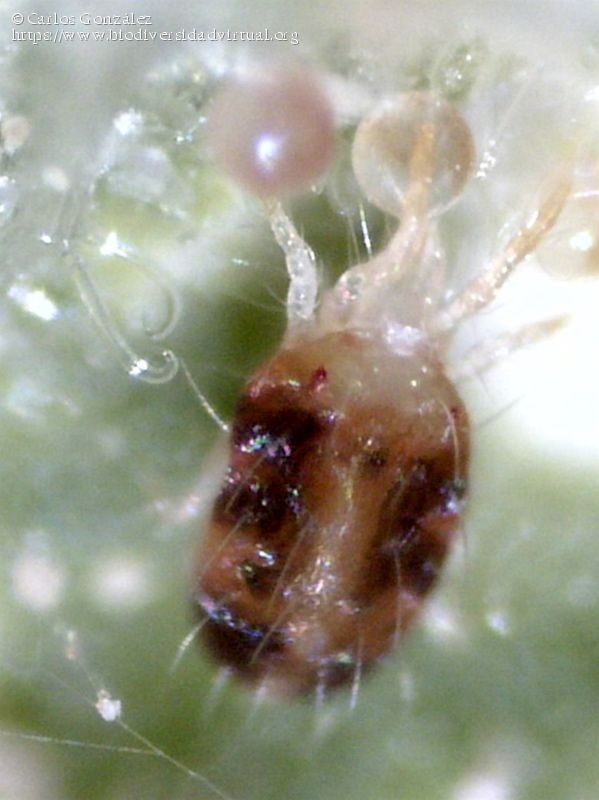

tetranychus urticae/113.80115704.jpg


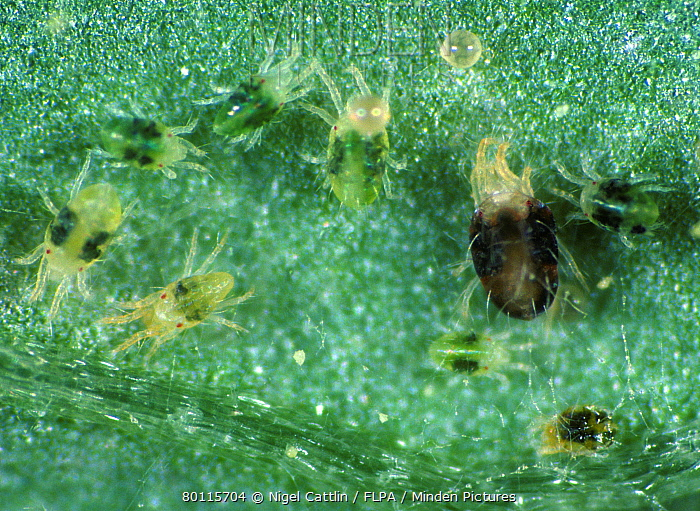

bemisia tabaci/144.un-nouvel-article-sur-bemisia-tabaci.jpg


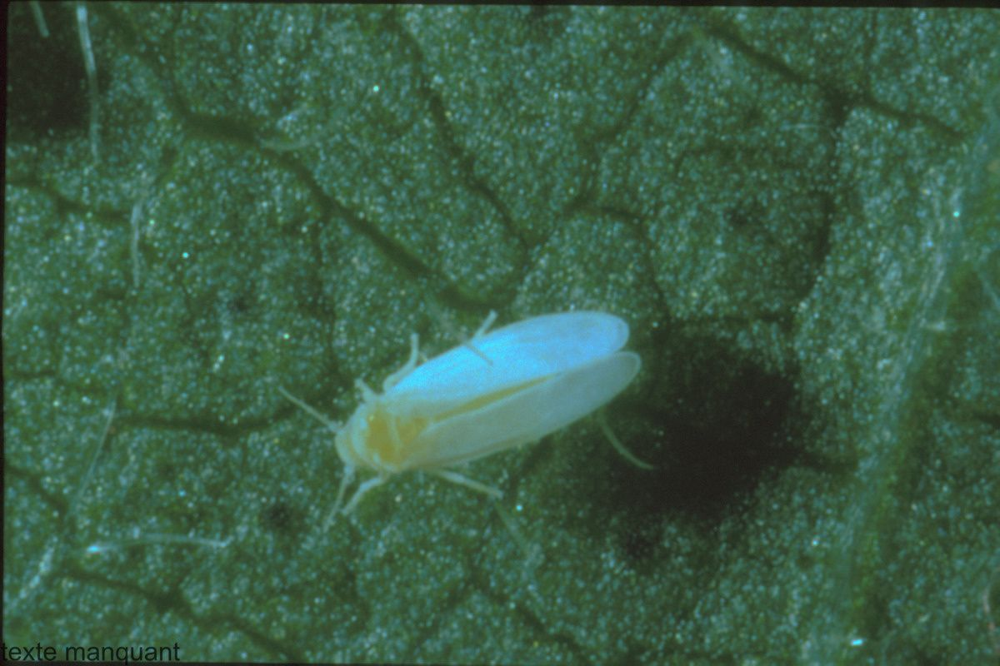

bemisia tabaci/13.Bemisia-tabaci.jpg


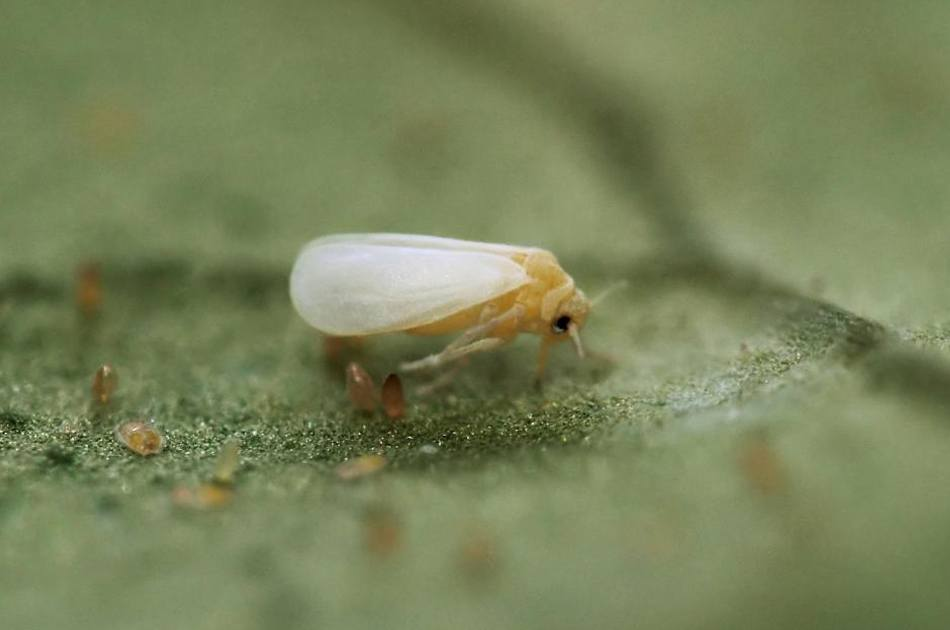

bemisia tabaci/117.Figura-8-Adultos-de-Bemisia-tabaci-en-el-enves-de-hoja-de-frijol-Foto-fpsorgmx.png


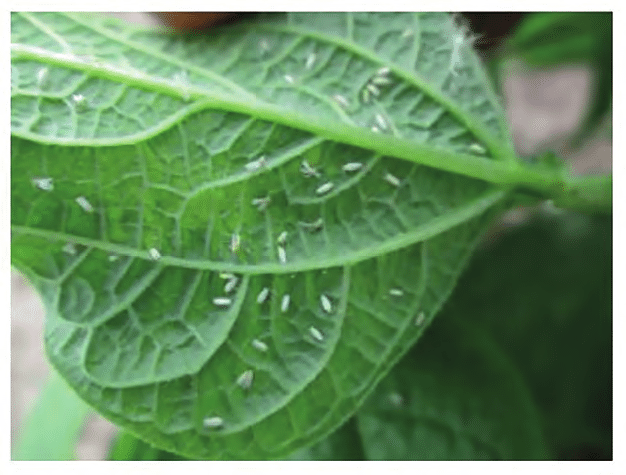

bemisia tabaci/143.283.jpg


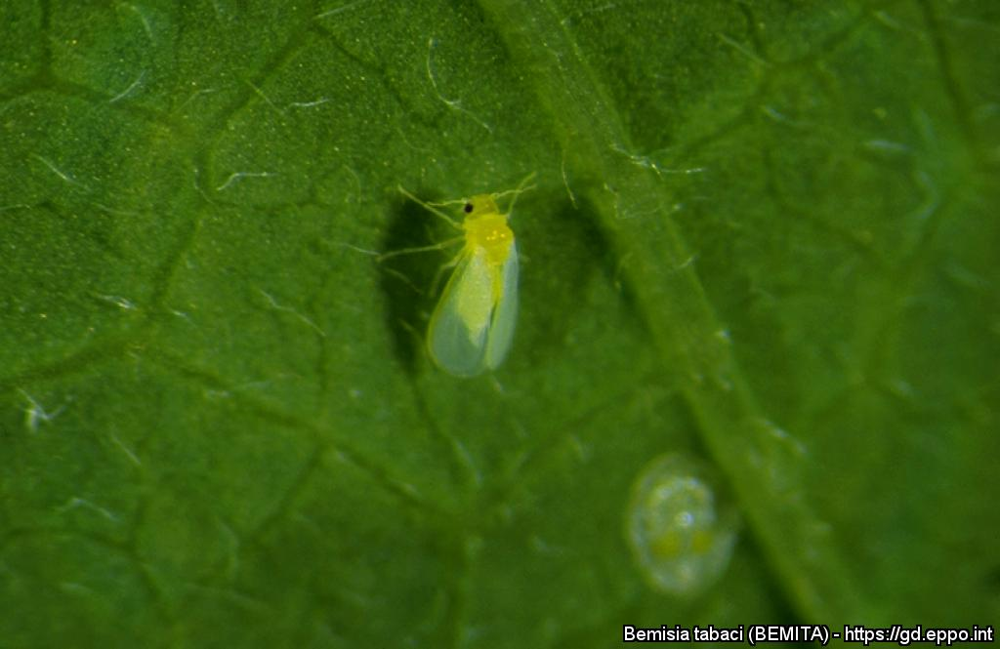

bemisia tabaci/105.Hemiptera-Sternorrhyncha-Aleyrodidae-Bemisia-tabaci-Sweetpotato-Whitefly-C.jpg


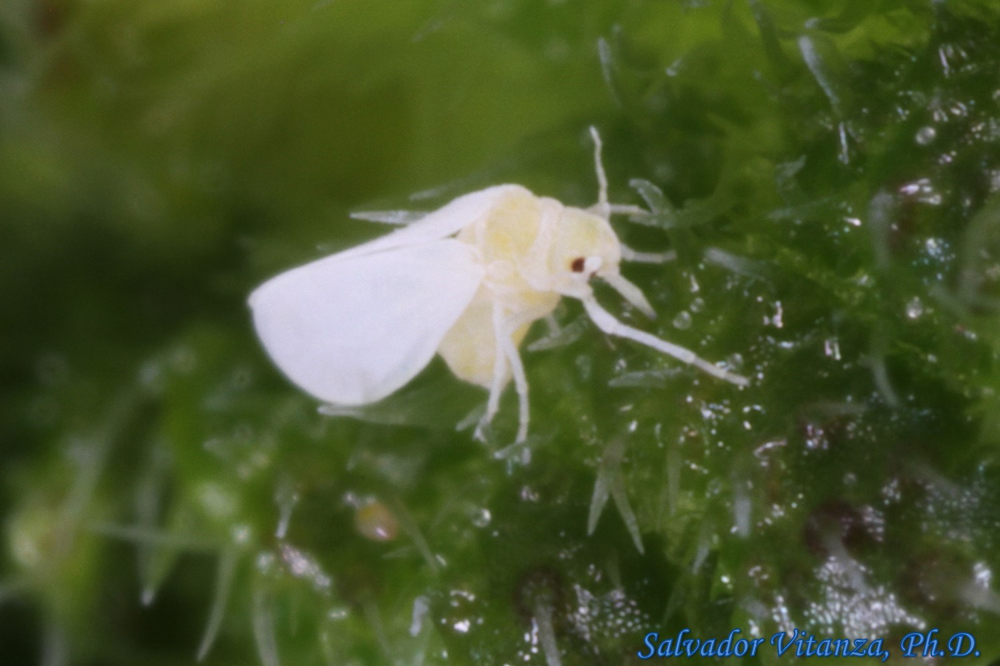

bemisia tabaci/140.5512052.jpg


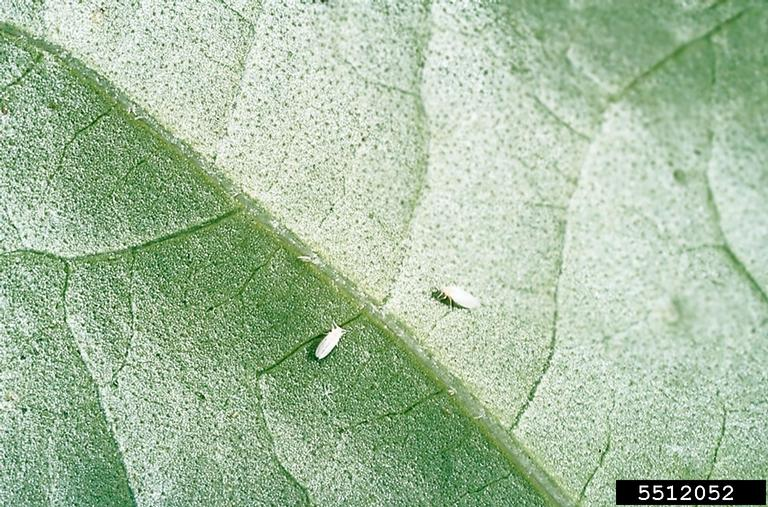

tetranychus urticae/13.f452fefd-compendioinsecticidasecologicos.jpg


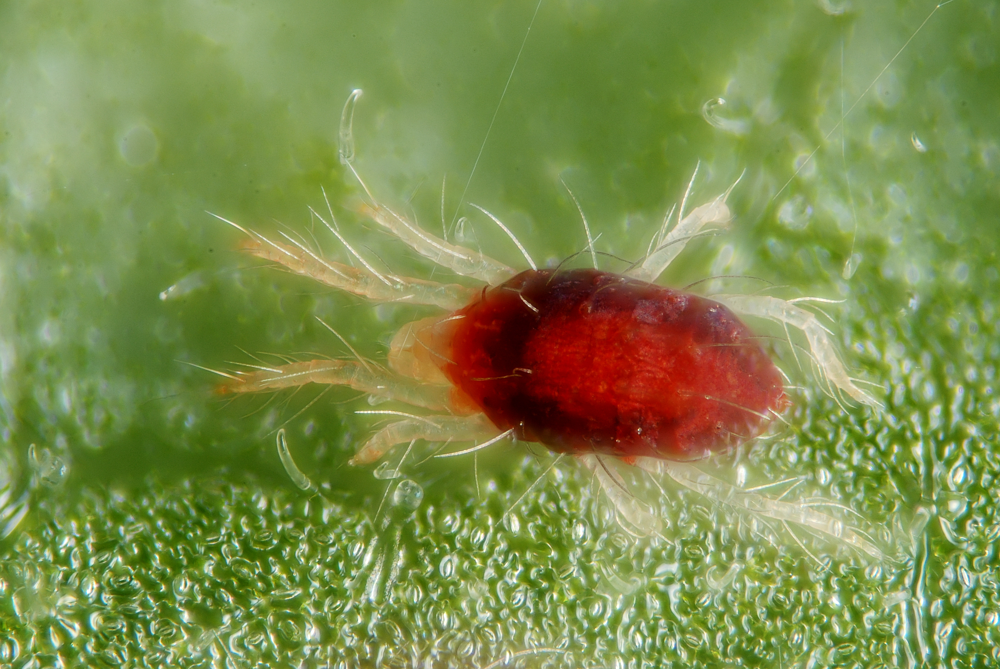

tetranychus urticae/121.VQZSAQJ0UQ30UQ307K304QWKSKPKLKEK0KCK9QBK9QY05KBKIKHS6QV06Q2KQKWKSKA0LK9KSKC06QRS.jpg


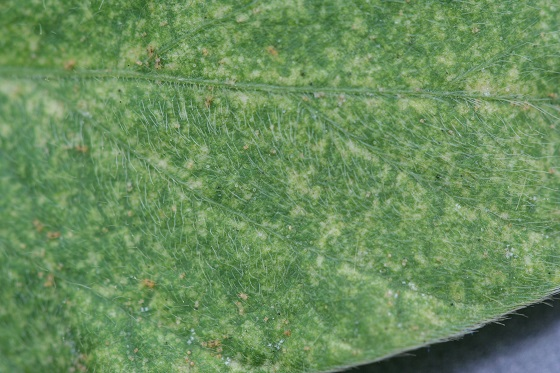

tetranychus urticae/137.d65wgu5-7a3d808a-2404-40cb-b8d3-44ae43083c6c.jpg


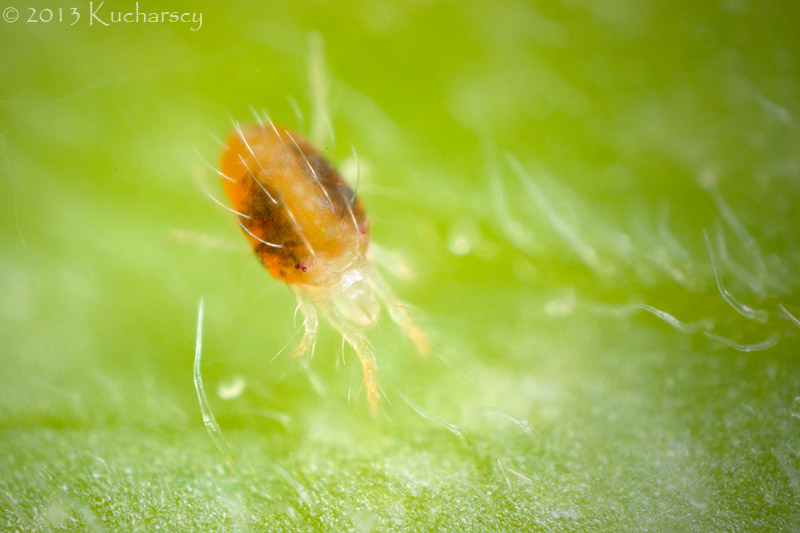

tetranychus urticae/15.twospotted_spider_mite01.jpg


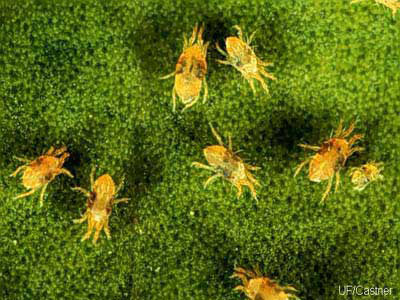

bemisia tabaci/114.a1m.jpg


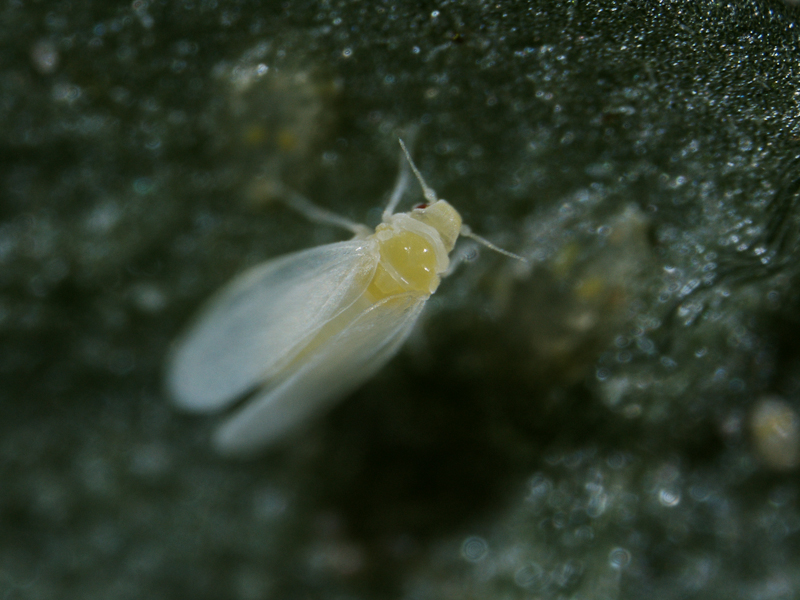

bemisia tabaci/125.silverleaf_whitefly21.JPG


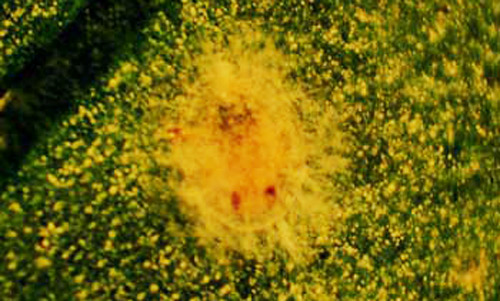

bemisia tabaci/110.0746015.jpg


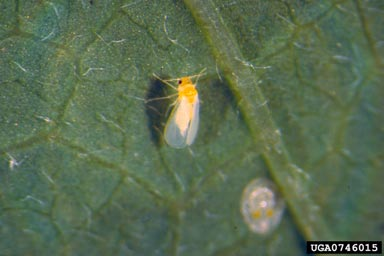

tetranychus urticae/130.tetranychus-urticae.jpg


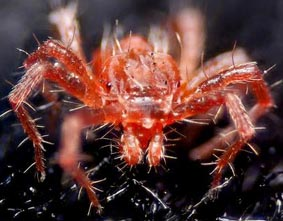

tetranychus urticae/131.maxresdefault.jpg


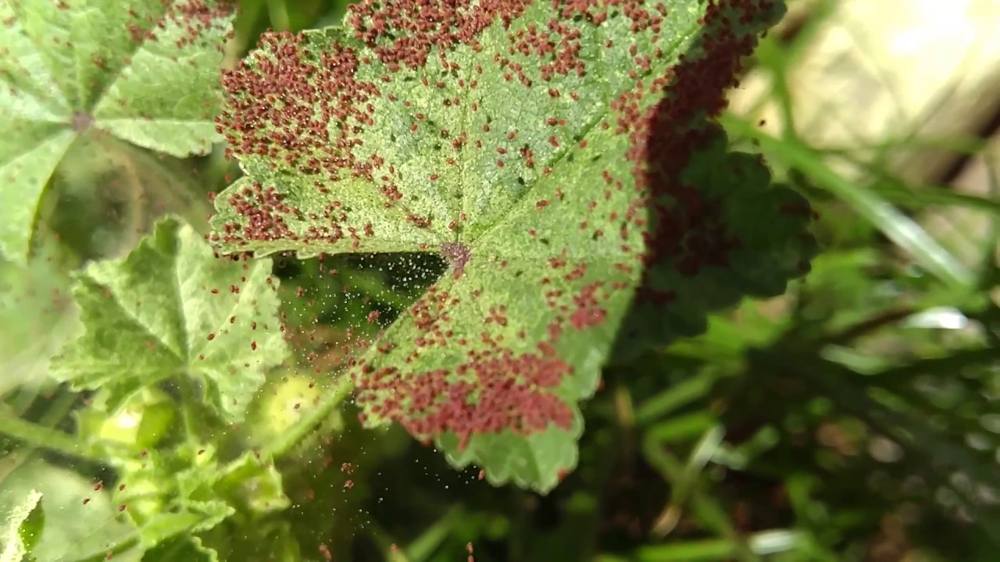

bemisia tabaci/132.293.jpg


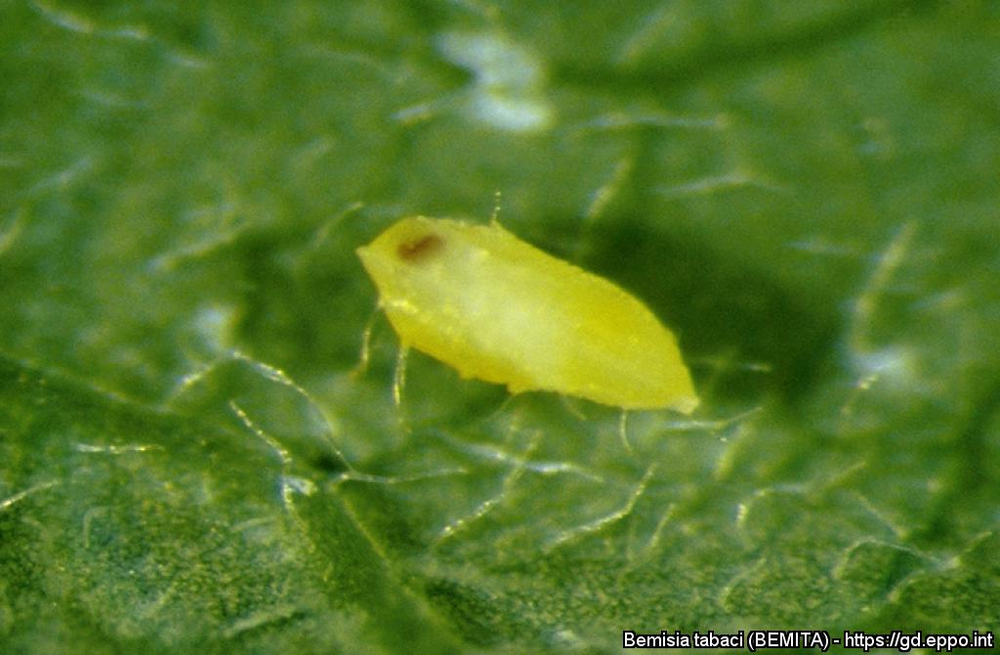

In [93]:
for sample in correct_samples_list:
    print(sample)
    display(ji(filename='./images/' + sample))

In [59]:
print(model.metrics_names)
print(model.evaluate_generator(val_generator))

['loss', 'accuracy']
[0.5170879662036896, 0.8023256]


In [46]:
model.save_weights('./checkpoints/my_checkpoint')

In [48]:
model.load_weights('./checkpoints/my_checkpoint')

In [50]:
model.save('./my_model.h5')

In [2]:
new_model = tf.keras.models.load_model('./my_model.h5')
new_model.summary()

W0616 12:04:56.346457 140593922766592 deprecation.py:323] From /export/JEFFDEANDISK/ccrespo/notebooks/bugs_venv/lib/python3.5/site-packages/tensorflow_core/python/ops/math_grad.py:1251: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Model) (None, 7, 7, 1280)        2257984   
_________________________________________________________________
conv2d (Conv2D)              (None, 5, 5, 64)          737344    
_________________________________________________________________
dropout (Dropout)            (None, 5, 5, 64)          0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 3, 3, 32)          18464     
_________________________________________________________________
dropout_1 (Dropout)          (None, 3, 3, 32)          0         
_________________________________________________________________
global_average_pooling2d (Gl (None, 32)                0         
_________________________________________________________________
dense (Dense)                (None, 2)                 6

In [ ]:
tfjs_target_path = 'nombre que quiera para guardarlo'
tfjs.converters.save_keras_model(new_model, tfjs_target_path)